In [ ]:
import pandas as pd
import numpy as np
import warnings

warnings.filterwarnings(action='ignore')

DATA_DIR = '/content/drive/MyDrive/투빅스 컨퍼런스/Data/'

# 게임 메타 데이터 가져오기

In [ ]:
content_df = pd.read_csv(DATA_DIR + 'steam_game_meta_data_final.csv')
content_df['idx'] = content_df.index
content_df.head()

,game_id,title,content,Image_url,genres,clean_genres,appid,name,developer,publisher,score_rank,positive,negative,userscore,owners,average_forever,average_2weeks,median_forever,median_2weeks,price,initialprice,discount,languages,genre,ccu,tags,label_encode_game_id,game_total_cnt,game_rec_cnt,game_not_rec_cnt,recommend_ratio,not_recommend_ratio,game_total_avg_play_time,game_rec_avg_play_time,game_not_rec_avg_play_time,idx
0,10,Counter-Strike,Play the world's number 1 online action game. ...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tAction\t\t\t\t\t...,"['Action', 'FPS', 'Multiplayer', 'Shooter', 'C...",10,Counter-Strike,Valve,Valve,NaN,178066,4597,0,"10,000,000 .. 20,000,000",12516,431,185,764,199.0,999.0,80.0,"English, French, German, Italian, Spanish - Sp...",Action,13111,"{'Action': 5355, 'FPS': 4771, 'Multiplayer': 3...",0,504,475.0,29.0,0.942460,0.057540,42992.559524,45121.048421,8129.379310,0
1,20,Team Fortress Classic,One of the most popular online action games of...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tAction\t\t\t\t\t...,"['Action', 'FPS', 'Multiplayer', 'Classic', 'H...",20,Team Fortress Classic,Valve,Valve,NaN,4949,838,0,"2,000,000 .. 5,000,000",2353,0,17,0,99.0,499.0,80.0,"English, French, German, Italian, Spanish - Sp...",Action,89,"{'Action': 741, 'FPS': 302, 'Multiplayer': 255...",1,164,130.0,34.0,0.792683,0.207317,11446.682927,14363.538462,294.000000,1
2,30,Day of Defeat,Enlist in an intense brand of Axis vs. Allied ...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tFPS\t\t\t\t\t\t\...,"['FPS', 'World War II', 'Multiplayer', 'Shoote...",30,Day of Defeat,Valve,Valve,NaN,4723,521,0,"5,000,000 .. 10,000,000",2164,0,39,0,99.0,499.0,80.0,"English, French, German, Italian, Spanish - Spain",Action,122,"{'FPS': 780, 'World War II': 245, 'Multiplayer...",2,107,87.0,20.0,0.813084,0.186916,23939.551402,28533.034483,3957.900000,2
3,40,Deathmatch Classic,Enjoy fast-paced multiplayer gaming with Death...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tAction\t\t\t\t\t...,"['Action', 'FPS', 'Classic', 'Multiplayer', 'S...",40,Deathmatch Classic,Valve,Valve,NaN,1733,377,0,"5,000,000 .. 10,000,000",2862,0,11,0,99.0,499.0,80.0,"English, French, German, Italian, Spanish - Sp...",Action,5,"{'Action': 627, 'FPS': 137, 'Classic': 105, 'M...",3,97,78.0,19.0,0.804124,0.195876,14408.845361,16979.000000,3857.684211,3
4,50,Half-Life: Opposing Force,Return to the Black Mesa Research Facility as ...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tFPS\t\t\t\t\t\t\...,"['FPS', 'Action', 'Classic', 'Sci-fi', 'Single...",50,Half-Life: Opposing Force,Gearbox Software,Valve,NaN,11285,581,0,"5,000,000 .. 10,000,000",1494,0,208,0,99.0,499.0,80.0,"English, French, German, Korean",Action,137,"{'FPS': 874, 'Action': 316, 'Sci-fi': 242, 'Cl...",4,293,276.0,17.0,0.941980,0.058020,4025.447099,3990.065217,4599.882353,4


# seq 벡터 가져오기

In [ ]:
from gensim.models import KeyedVectors

rec_yes_shuffle_yes_model_min_count_1 = KeyedVectors.load_word2vec_format(DATA_DIR + "rec_yes_shuffle_yes_model_min_count_1") # 모델 로드

game_id_li = content_df['game_id'].astype(str).tolist()

seq_vecs = []

for game_id in game_id_li:
  seq_vecs += [rec_yes_shuffle_yes_model_min_count_1[game_id]]

seq_vecs = np.concatenate([seq_vecs], axis = 1)
seq_vecs.shape

(22443, 300)

In [ ]:
norm_seq_vecs = seq_vecs / np.linalg.norm(seq_vecs, axis = 1).reshape(-1,1)
np.linalg.norm(norm_seq_vecs, axis = 1)

array([1.        , 1.        , 1.        , ..., 0.99999994, 1.        ,
       1.        ], dtype=float32)

In [ ]:
def get_min_max_data(vec):
  return ((vec - vec.min(axis = 0)) / (vec.max(axis = 0) - vec.min(axis = 0)))

In [ ]:
min_max_seq_vecs = get_min_max_data(seq_vecs)
min_max_seq_vecs.max()

1.0

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler=StandardScaler()
standard_seq_vecs = scaler.fit_transform(seq_vecs)

In [ ]:
standard_seq_vecs

array([[-0.05771312, -0.34836334, -0.94094735, ..., -0.20401801,
        -0.1145611 , -0.25893465],
       [-0.27475163, -0.31755906, -0.23579767, ..., -0.2764435 ,
        -0.32371607, -0.99468094],
       [-0.18659249, -0.4926373 , -1.1490365 , ..., -1.3406959 ,
        -0.8227513 , -0.3633815 ],
       ...,
       [-0.58578163, -1.0962301 ,  0.52512085, ...,  0.16777718,
        -0.6295141 , -0.29947025],
       [ 1.2447062 , -2.1663504 , -0.6677685 , ...,  0.59152716,
         0.6273724 , -0.66120654],
       [ 0.88015765,  1.36147   , -0.3574996 , ...,  0.29408446,
        -0.8573883 ,  1.1675338 ]], dtype=float32)

# img 벡터 가져오기

In [ ]:
import pickle

# load
with open(DATA_DIR + 'img_vecs.pickle', 'rb') as f:
  img_vecs = pickle.load(f)

img_vecs.shape

(22443, 128)

In [ ]:
norm_img_vecs = img_vecs / np.linalg.norm(img_vecs, axis = 1).reshape(-1,1)
np.linalg.norm(norm_img_vecs, axis = 1)

array([0.99999994, 1.        , 1.        , ..., 0.99999994, 1.        ,
       1.        ], dtype=float32)

In [ ]:
min_max_img_vecs = get_min_max_data(img_vecs)
min_max_img_vecs.max()

1.0

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
standard_img_vecs = scaler.fit_transform(img_vecs)

In [ ]:
standard_img_vecs

array([[-1.0662558 , -1.1339397 , -0.9233774 , ..., -0.24490042,
         0.762628  ,  1.7188951 ],
       [-0.53756154, -1.4460629 ,  0.5356339 , ...,  0.2447201 ,
         0.01096553,  0.5988529 ],
       [-0.39012656, -0.38279566, -0.25503474, ...,  0.5366381 ,
        -0.0824709 ,  0.35814846],
       ...,
       [ 0.5129387 , -1.4944406 ,  0.8340276 , ...,  0.5132032 ,
         0.12107281,  1.2207836 ],
       [-2.2078137 ,  0.5236333 , -0.6682167 , ..., -2.0807018 ,
        -0.68938667, -1.6461055 ],
       [ 0.63323605, -0.6011933 ,  0.5235484 , ...,  0.05888359,
         0.47175646, -0.1391607 ]], dtype=float32)

# gen 벡터 가져오기

In [ ]:
import pickle

# load
with open(DATA_DIR + 'genres_vecs.pickle', 'rb') as f:
  gen_vecs = pickle.load(f)

gen_vecs.shape

(22443, 128)

In [ ]:
norm_gen_vecs = gen_vecs / np.linalg.norm(gen_vecs, axis = 1).reshape(-1,1)
np.linalg.norm(norm_gen_vecs, axis = 1)

array([1.        , 0.99999994, 1.        , ..., 1.        , 1.        ,
       1.        ], dtype=float32)

In [ ]:
min_max_gen_vecs = get_min_max_data(gen_vecs)
min_max_gen_vecs.max()

1.0

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler=StandardScaler()
standard_gen_vecs = scaler.fit_transform(gen_vecs)

In [ ]:
standard_gen_vecs

array([[-0.6331636 ,  2.9831169 , -0.79966253, ..., -0.17254534,
         2.255994  , -2.181406  ],
       [-1.5592535 ,  2.3371546 , -1.5628251 , ..., -1.3053015 ,
         1.2208425 , -1.0253905 ],
       [-0.8863196 ,  0.39602298, -0.5956031 , ..., -0.68535674,
         1.6515888 , -0.61384326],
       ...,
       [-0.02947061,  0.8025182 ,  1.5361384 , ..., -2.0587256 ,
         0.36905447,  1.1209346 ],
       [-0.11040884, -0.5235565 ,  1.1372952 , ..., -1.8070998 ,
         0.23253435, -0.05333308],
       [ 0.40044233,  0.8796731 ,  0.7158607 , ...,  1.6842754 ,
        -1.8828096 ,  0.44001845]], dtype=float32)

# game2vec 만들기

In [ ]:
game2vec = np.concatenate([seq_vecs, img_vecs, gen_vecs], axis = 1)
game2vec.shape

(22443, 556)

In [ ]:
norm_game2vec = np.concatenate([norm_seq_vecs, norm_img_vecs, norm_gen_vecs], axis = 1)
np.linalg.norm(norm_game2vec, axis = 1)

array([1.7320508, 1.7320508, 1.7320509, ..., 1.7320508, 1.7320509,
       1.7320508], dtype=float32)

In [ ]:
min_max_game2vec = get_min_max_data(game2vec)
min_max_game2vec.max()

1.0

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler=StandardScaler()
standard_game2vec = scaler.fit_transform(game2vec)

In [ ]:
standard_game2vec

array([[-0.05771312, -0.34836334, -0.94094735, ..., -0.17254534,
         2.255994  , -2.181406  ],
       [-0.27475163, -0.31755906, -0.23579767, ..., -1.3053015 ,
         1.2208425 , -1.0253905 ],
       [-0.18659249, -0.4926373 , -1.1490365 , ..., -0.68535674,
         1.6515888 , -0.61384326],
       ...,
       [-0.58578163, -1.0962301 ,  0.52512085, ..., -2.0587256 ,
         0.36905447,  1.1209346 ],
       [ 1.2447062 , -2.1663504 , -0.6677685 , ..., -1.8070998 ,
         0.23253435, -0.05333308],
       [ 0.88015765,  1.36147   , -0.3574996 , ...,  1.6842754 ,
        -1.8828096 ,  0.44001845]], dtype=float32)

# 평가 함수 정의

In [ ]:
import pickle

DATA_DIR = '/content/drive/MyDrive/투빅스 컨퍼런스/Data/'

image_dict = {}

# load
for i in range(5):
  with open(DATA_DIR + f'image_data_dict_v2_{i + 1}.pickle', 'rb') as f:
      image = pickle.load(f)
      
  image_dict.update(image)

len(image_dict)

22458

In [ ]:
idx2tite = {}

idx2content = {}

idx2clean_genres = {}

idx2game_id = {}

def get_data(x):
  idx2tite[x['idx']] = x['title']
  idx2content[x['idx']] = x['content']
  idx2clean_genres[x['idx']] = x['clean_genres']
  idx2game_id[x['idx']] = x['game_id']

_ = content_df.apply(lambda x : get_data(x), axis = 1)

In [ ]:
from PIL import Image

def cos_sim(A, B):
  return np.dot(A, B) / (np.linalg.norm(A)*np.linalg.norm(B))

def dis_sim(A, B):
  return np.linalg.norm(A - B)

def get_sim_game(vecs, idx, top = 5):
  sim_scores = [cos_sim(vecs[idx], vecs[i]) for i in range(vecs.shape[0])]
  sim_scores = [(i, c) for i, c in enumerate(sim_scores) if i != idx] # 자기 자신을 제외한 영화들의 유사도 및 인덱스를 추출 
  sim_scores = sorted(sim_scores, key = lambda x: x[1], reverse=True)

  choise_game_title = idx2tite[idx]
  choise_game_content = idx2content[idx]
  choise_game_clean_genres = idx2clean_genres[idx]
  choise_game_game_id = idx2game_id[idx]
  
  print('-'*100)
  print(f'선택된 게임의 ID: {choise_game_game_id}, 선택된 게임의 title: {choise_game_title}')
  print(f'선택된 게임의 content: {choise_game_content}')
  print(f'선택된 게임의 genres: {choise_game_clean_genres}')
  img = Image.fromarray(image_dict[int(choise_game_game_id)])
  display(img)
  print('-'*100)

  for idx, (i, sim_score) in enumerate(sim_scores[0:top]):
    sim_game_title = idx2tite[i]
    sim_game_content = idx2content[i]
    sim_game_clean_genres = idx2clean_genres[i]
    sim_game_game_id = idx2game_id[i]

    print('-'*100)
    print(f'TOP{idx + 1} 게임의 ID: {sim_game_game_id}, title: {sim_game_title}, Score: {sim_score}')
    print(f'선택된 게임의 content: {sim_game_content}')
    print(f'선택된 게임의 genres: {sim_game_clean_genres}')
    img = Image.fromarray(image_dict[int(sim_game_game_id)])
    display(img)
    print('-'*100)

# 평가

In [ ]:
content_df[content_df['game_id'] == 666140]

,game_id,title,content,Image_url,genres,clean_genres,appid,name,developer,publisher,score_rank,positive,negative,userscore,owners,average_forever,average_2weeks,median_forever,median_2weeks,price,initialprice,discount,languages,genre,ccu,tags,label_encode_game_id,game_total_cnt,game_rec_cnt,game_not_rec_cnt,recommend_ratio,not_recommend_ratio,game_total_avg_play_time,game_rec_avg_play_time,game_not_rec_avg_play_time,idx
13493,666140,My Time At Portia,Start a new life in the enchanting town of Por...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tRPG\t\t\t\t\t\t\...,"['RPG', 'Life Sim', 'Open World', 'Farming Sim...",666140,My Time At Portia,Pathea Games,Team17,NaN,29902,2275,0,"1,000,000 .. 2,000,000",1573,2870,816,2870,1019.0,2999.0,66.0,"English, Simplified Chinese, French, German, T...","Adventure, Casual, Indie, RPG, Simulation",1717,"{'RPG': 618, 'Life Sim': 581, 'Open World': 58...",13493,409,351.0,58.0,0.858191,0.141809,5765.633252,6447.538462,1638.931034,13493


----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 666140, 선택된 게임의 title: My Time At Portia
선택된 게임의 content: Start a new life in the enchanting town of Portia! Restore your Pa's neglected workshop to its former glory by fulfilling commissions, growing crops, raising animals, and befriending the quirky inhabitants of this charming post-apocalyptic land!
선택된 게임의 genres: ['RPG', 'Life Sim', 'Open World', 'Farming Sim', 'Simulation', 'Crafting', 'Casual', 'Adventure', 'Singleplayer', 'Agriculture', 'Building', 'Indie', 'Sandbox', 'Mining', 'Relaxing', 'Exploration', 'Survival', 'Cartoony', 'Post-apocalyptic', 'Female Protagonist']


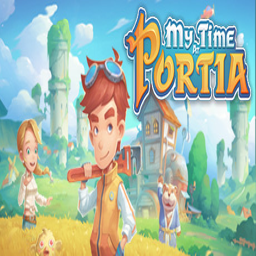

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 751780, title: Forager, Score: 0.5760026574134827
선택된 게임의 content: The highly popular and quirky "idle game that you want to actively keep playing". Explore, craft, gather & manage resources, find secrets and build your base out of nothing! Buy land to explore and expand!
선택된 게임의 genres: ['Open World Survival Craft', 'Survival', 'Crafting', 'Pixel Graphics', 'Farming Sim', 'Indie', 'Adventure', 'Sandbox', '2D', 'Base Building', 'Multiplayer', 'Singleplayer', 'Building', 'Resource Management', 'Exploration', 'Open World', 'RPG', 'Casual', 'Agriculture', 'Simulation']


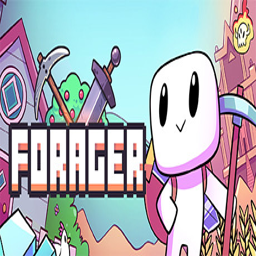

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1040630, title: Alchemy Story, Score: 0.5406364798545837
선택된 게임의 content: Discover a world of magic, cute creatures and adventure in Alchemy Story, a casual farming simulation game! Grow your garden, brew potions, care for your pets and meet new friends!
선택된 게임의 genres: ['Farming Sim', 'Simulation', 'Agriculture', 'Cute', 'RPG', 'Crafting', 'Casual', 'Singleplayer', 'Indie', 'Relaxing', 'Dating Sim', 'Fishing', 'Cartoony', 'Female Protagonist', 'Family Friendly', 'Life Sim', '3D', 'Magic', 'LGBTQ', 'Romance']


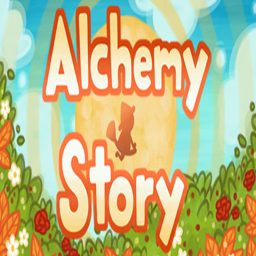

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 894940, title: Littlewood, Score: 0.5336632132530212
선택된 게임의 content: The world has already been saved. Now it's time to rebuild your town, learn new hobbies, and forge lifelong friendships in this peaceful and relaxing RPG.
선택된 게임의 genres: ['Pixel Graphics', 'Life Sim', 'City Builder', 'Simulation', 'RPG', 'Agriculture', 'Relaxing', 'Crafting', 'Sandbox', 'Building', 'Collectathon', 'Open World', 'Casual', 'Exploration', 'Farming Sim', 'Romance', 'Character Customization', '2D', 'Cute', 'Fishing']


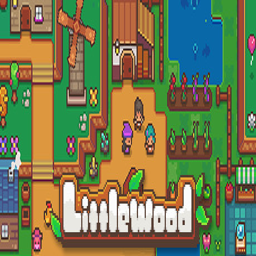

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 580200, title: Yonder: The Cloud Catcher Chronicles, Score: 0.5254682898521423
선택된 게임의 content: Unwind and enjoy the slow life in Yonder: The Cloud Catcher Chronicles, a relaxing open-world adventure game. Yonder is set in the world of Gemea. A natural island paradise with eight distinct environments ranging from tropical beaches to snow-capped summits.
선택된 게임의 genres: ['Open World', 'Adventure', 'Exploration', 'Crafting', 'Relaxing', 'Farming Sim', 'Cute', 'Indie', 'Singleplayer', 'Casual', 'Sandbox', 'Building', 'Agriculture', 'Atmospheric', 'Family Friendly', 'Fantasy', 'Third Person', 'RPG', 'Fishing', 'Multiplayer']


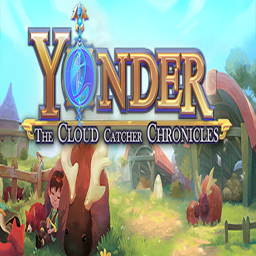

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 413150, title: Stardew Valley, Score: 0.5223906636238098
선택된 게임의 content: You've inherited your grandfather's old farm plot in Stardew Valley. Armed with hand-me-down tools and a few coins, you set out to begin your new life. Can you learn to live off the land and turn these overgrown fields into a thriving home?
선택된 게임의 genres: ['Farming Sim', 'Life Sim', 'RPG', 'Pixel Graphics', 'Agriculture', 'Multiplayer', 'Simulation', 'Relaxing', 'Crafting', 'Sandbox', 'Indie', 'Building', 'Singleplayer', 'Casual', 'Open World', '2D', 'Great Soundtrack', 'Cute', 'Dating Sim', 'Fishing']


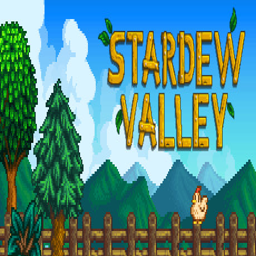

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 978780, title: STORY OF SEASONS: Friends of Mineral Town, Score: 0.5008325576782227
선택된 게임의 content: Experience the joys of life on the farm in this reimagining of a timeless STORY OF SEASONS classic!
선택된 게임의 genres: ['Simulation', 'Farming Sim', 'Casual', 'RPG', 'Dating Sim', 'Singleplayer', 'Cute', 'Anime', 'Romance', 'Female Protagonist', 'Relaxing', 'Life Sim', 'Agriculture', 'Open World', 'Remake', 'Multiplayer']


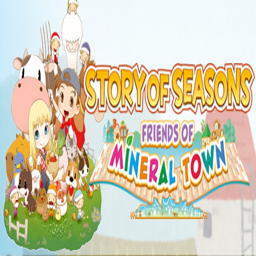

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 965230, title: DORAEMON  STORY OF SEASONS, Score: 0.4919956624507904
선택된 게임의 content: Japan's adored Doraemon meets Story of Seasons in this new, fresh take on farming, now on Steam! The setting is Natura, and the theme is creating bonds. While doing so, enjoy the heartwarming interactions through each character in the story!
선택된 게임의 genres: ['Farming Sim', 'Life Sim', 'RPG', 'Family Friendly', 'Adventure', 'Simulation', 'Singleplayer', 'Hand-drawn', '2D', 'Cute', 'Relaxing', 'Isometric', 'Colorful', 'Atmospheric', 'Crafting', 'Anime', 'Nostalgia', 'Cartoon', 'Casual', 'Farming']


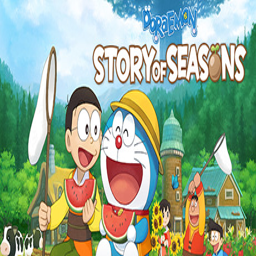

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 1472660, title: No Place Like Home, Score: 0.4525640308856964
선택된 게임의 content: Humanity Trashed the Earth and left for Mars. Only few remained. EXPLORE the world. Clean the environment, CRAFT with recycled resources. Domesticate animals. Rebuild your village. Restore environment and run your own post-apo FARM as there is No Place Like Home!
선택된 게임의 genres: ['Early Access', 'Farming Sim', 'RPG', 'Base Building', 'Crafting', 'Life Sim', 'Simulation', 'Exploration', 'Immersive Sim', 'Agriculture', 'Building', 'Fishing', 'Nature', 'Female Protagonist', '3D', 'Relaxing', 'Cute', 'Third Person', 'Post-apocalyptic', 'Open World']


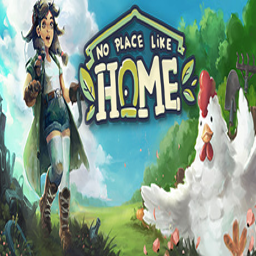

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 1338330, title: Lemon Cake, Score: 0.4474046230316162
선택된 게임의 content: Restore an abandoned bakery and prepare pastries from farm to table! Grow fresh ingredients in the greenhouse, cook pastries & sweets in the kitchen and serve your baked goods to hungry customers in your own shop!
선택된 게임의 genres: ['Simulation', 'Casual', 'Farming Sim', 'Time Management', 'Management', 'Life Sim', 'Cute', 'RPG', '3D', 'Colorful', 'Agriculture', 'Indie', 'Family Friendly', 'Relaxing', 'Character Customization', 'Crafting', 'Building', 'Singleplayer', 'Cooking']


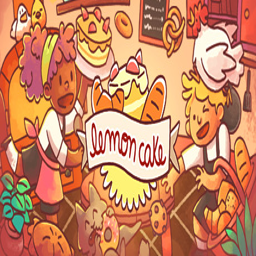

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 1138580, title: Farmington County: The Ultimate Farming Tycoon Simulator, Score: 0.44332876801490784
선택된 게임의 content: Farming & town living sim. Develop the farm of your dreams using tools, tractors, trucks & other vehicles. Build cabins, sheds, barns, and more! Hire workers to help out in your farm. Grow thousands of crops, raise hundreds of livestock and explore the world of Farmington County!
선택된 게임의 genres: ['Farming Sim', 'Simulation', 'Indie', 'Strategy', 'Early Access', 'Agriculture', 'Life Sim', 'Building', 'Base Building', 'Relaxing', 'Open World', 'Singleplayer', 'Sandbox', 'Casual', 'Management', 'Resource Management', 'Adventure', 'Immersive Sim', '3D', 'Top-Down']


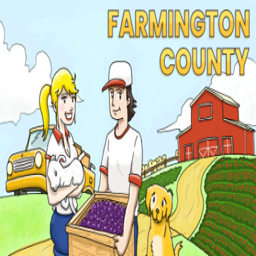

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP11 게임의 ID: 1323900, title: Scrapnaut, Score: 0.44268718361854553
선택된 게임의 content: Scrapnaut is a top-down, base building survival game with steampunk elements. Explore an open world with different biomes, take care of oxygen, manage your farms, generate electricity, build your home and much more!
선택된 게임의 genres: ['Early Access', 'Adventure', 'Building', 'Survival', 'Exploration', 'Sandbox', 'Open World Survival Craft', 'Top-Down', 'Atmospheric', 'Crafting', 'Post-apocalyptic', 'Robots', 'Open World', 'Indie', 'Singleplayer', 'Steampunk', 'Multiplayer', 'Co-op', 'Online Co-Op', '3D']


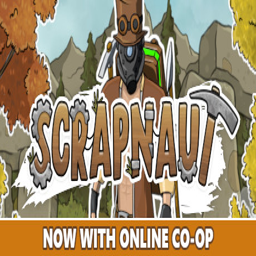

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP12 게임의 ID: 1337010, title: Alba: A Wildlife Adventure, Score: 0.4421024024486542
선택된 게임의 content: Even the smallest person can make a big difference. Join Alba, as she sets out to save her beautiful island and its wildlife. And possibly start a revolution.
선택된 게임의 genres: ['Casual', 'Female Protagonist', 'Adventure', '3D', 'Family Friendly', 'Funny', 'Nature', 'Story Rich', 'Cartoony', 'Exploration', 'Singleplayer', 'Open World', 'Creature Collector', 'Cute', 'Colorful', 'Cartoon', 'Relaxing', 'Stylized', 'Atmospheric', 'Indie']


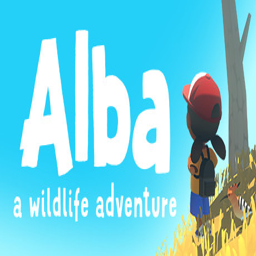

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP13 게임의 ID: 416000, title: Fantasy Farming: Orange Season, Score: 0.4392904043197632
선택된 게임의 content: Make your farmers dream come true in Orange Town. Start with a plot of land and build a thriving farm as you explore the charming village and befriend its eccentric residents. Grow crops, raise animals, fish and mine to establish your farm in town. What will your story be?
선택된 게임의 genres: ['Early Access', 'Dating Sim', 'Singleplayer', 'RPG', 'Adventure', 'Fishing', 'Agriculture', '2.5D', '2D', 'Farming Sim', 'Pixel Graphics', 'Relaxing', 'Controller', 'Romance', 'LGBTQ', 'Casual', 'Building', 'Cute', 'Fantasy', 'Open World']


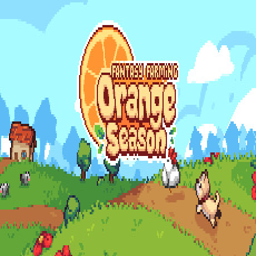

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP14 게임의 ID: 824000, title: Hokko Life, Score: 0.43836212158203125
선택된 게임의 content: Hop off the train and into your new life in the village of Hokko! Take over the old workshop and get creative; use crafted materials and design everything in town! With complete creative freedom, what type of town will you build?
선택된 게임의 genres: ['Simulation', 'Casual', 'Indie', 'RPG', 'Adventure', 'Early Access', 'Life Sim', 'Farming Sim', 'Cute', 'Building', 'Relaxing', 'Character Customization', 'Singleplayer', '3D', 'Third Person', 'Crafting', 'Colorful', 'Family Friendly', 'Fishing', 'Multiplayer']


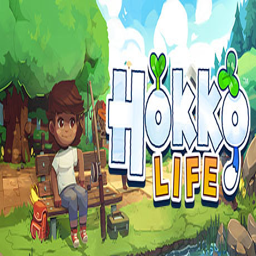

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP15 게임의 ID: 618850, title: Pumpkin Days, Score: 0.43570542335510254
선택된 게임의 content: Pumpkin Days is a traditional farming RPG. Pick one of three towns to start your farming adventure. Farm, fish, mine, catch bugs, raise animals, and more. Help fill out the museum to stop a factory from being built on the island. Unless you wish to side with the factory. The choice is yours.
선택된 게임의 genres: ['Farming Sim', 'Simulation', 'RPG', 'Casual', 'Indie', 'Agriculture', 'Anime', 'LGBTQ', 'Character Customization']


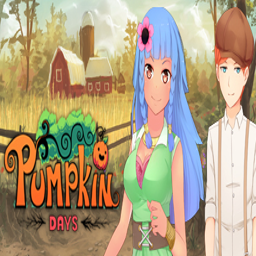

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP16 게임의 ID: 582270, title: Everything, Score: 0.43480369448661804
선택된 게임의 content: Be the Universe in this epic, award-winning reality simulation game - featuring thousands of playable characters, endless exploration, an extraordinary soundtrack and narration from Alan Watts.
선택된 게임의 genres: ['Simulation', 'Casual', 'Philosophical', 'Indie', 'Relaxing', 'Sandbox', 'Open World', 'RPG', 'Exploration', 'Atmospheric', 'Singleplayer', 'Experimental', 'God Game', 'Funny', 'Great Soundtrack', 'Experience', 'Procedural Generation', 'Walking Simulator', 'Family Friendly', 'Adventure']


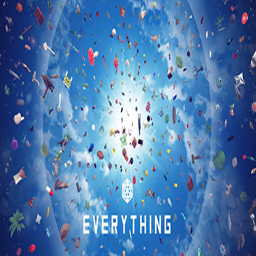

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP17 게임의 ID: 560130, title: Pillars of Eternity II: Deadfire, Score: 0.4316506087779999
선택된 게임의 content: Patch 5.0 - Turn-based mode and The Ultimate challenge out now! Pursue a rogue god over land and sea in the sequel to the multi-award-winning RPG Pillars of Eternity. Captain your ship on a dangerous voyage of discovery across the vast unexplored archipelago region of the Deadfire.
선택된 게임의 genres: ['RPG', 'Party-Based RPG', 'Isometric', 'Story Rich', 'Fantasy', 'Singleplayer', 'CRPG', 'Character Customization', 'Choices Matter', 'Open World', 'Real-Time with Pause', 'Turn-Based', 'Adventure', 'Pirates', 'Nudity', 'Exploration', 'Great Soundtrack', 'Atmospheric', 'Romance', 'Female Protagonist']


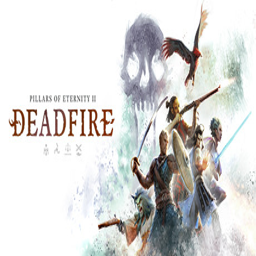

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP18 게임의 ID: 664000, title: HammerHelm, Score: 0.431143194437027
선택된 게임의 content: HammerHelm is a unique blend of third-person adventuring and strategic town building. Create your dwarf character and build a flourishing town above ground. Complete quests, craft weapons and armor, defeat dangerous enemies and be the leader your townspeople need!
선택된 게임의 genres: ['Building', 'Action-Adventure', 'Crafting', 'Fantasy', 'Open World', 'Adventure', 'Third Person', 'City Builder', 'Colorful', 'Open World Survival Craft', 'Relaxing', 'Singleplayer', 'RPG', 'Base Building', 'Indie', 'Family Friendly', 'Early Access', 'Simulation', 'Cartoony', 'Resource Management']


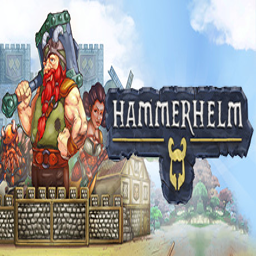

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP19 게임의 ID: 962580, title: Summer in Mara, Score: 0.42623963952064514
선택된 게임의 content: Take care of your own island and explore the ocean in this farming adventure. Summer in Mara mix farming, crafting and exploring mechanic in a tropical archipelago with a colorful style and strong narrative.
선택된 게임의 genres: ['Visual Novel', 'Emotional', 'Farming Sim', 'Relaxing', 'Life Sim', 'Surreal', 'Exploration', 'Hand-drawn', 'Agriculture', 'Crafting', 'Colorful', 'Nature', 'Female Protagonist', 'Cute', 'Casual', 'Sandbox', 'Adventure', 'Collectathon', 'Fantasy', 'Anime']


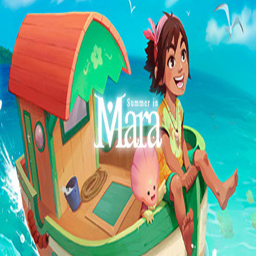

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP20 게임의 ID: 853550, title: Equilinox, Score: 0.4250859320163727
선택된 게임의 content: Equilinox is a relaxing nature simulation game in which you can create and nurture your own ecosystems. Shape the world to your liking, cultivate and raise hundreds of different species, and evolve your wildlife to unlock more exotic plants and animals.
선택된 게임의 genres: ['Simulation', 'Indie', 'Casual', 'Sandbox', 'Relaxing', 'Singleplayer', 'Nature', 'Great Soundtrack', 'God Game', 'Atmospheric', 'Management', 'Family Friendly', 'Colorful', 'Beautiful']


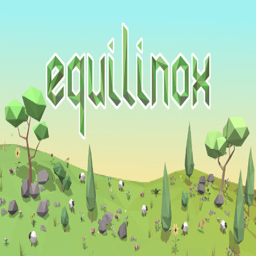

----------------------------------------------------------------------------------------------------


In [ ]:
# My Time At Portia / 666140
get_sim_game(norm_game2vec, 13493, top = 20)

## 이미지

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


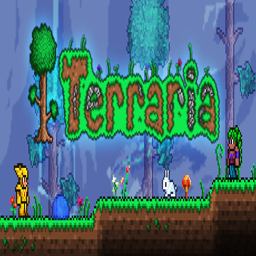

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 918170, title: Curiosity, Score: 0.7164986729621887
선택된 게임의 content: A simple world where the player is able to change things that are not supposed to be changed. Welcome to Curiosity, the game where you can hack. Try out different hacks, get creative, entertain yourself! And hey, maybe you'll find a secret or two along the way!
선택된 게임의 genres: ['Free to Play', 'Casual', 'Indie']


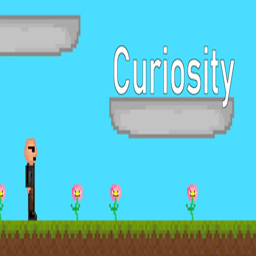

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1247170, title: Alien Cat, Score: 0.7115766406059265
선택된 게임의 content: Save the Universe with the Alien-Cat in this brand new puzzle-platformer game! Jump on your enemies heads, push the boxes and walk on the ceiling.
선택된 게임의 genres: ['Indie', 'Casual', 'Short', 'Family Friendly', 'Difficult', 'Adventure', 'Platformer']


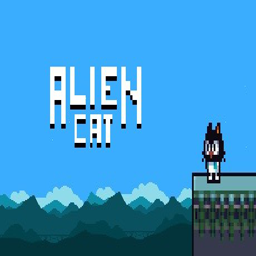

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.6893984079360962
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


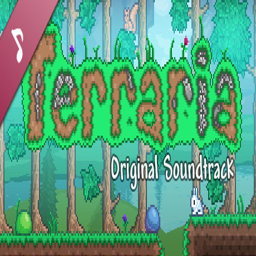

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1201840, title: MAN STANDING, Score: 0.6532325148582458
선택된 게임의 content: The ALFINA GAMERS team together with ALFINA WORLD GAME PUBLISHING are pleased to present a unique game experience. Get ready to challenge nature, incredible dangers, serious enemies, and most importantly - yourself.
선택된 게임의 genres: ['Adventure', 'Action', 'Simulation', 'Indie', 'Philosophical', 'Walking Simulator', 'Story Rich', 'Atmospheric', 'Parody ', 'Violent', 'Gore', 'Memes', 'Great Soundtrack', 'Exploration', 'Psychological Horror', 'Mystery', 'Anime', 'Hentai', 'Sexual Content']


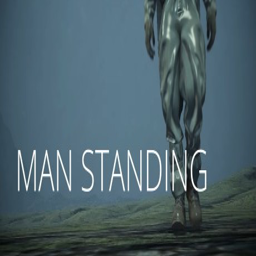

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 401280, title: Nubs' Adventure, Score: 0.6414402723312378
선택된 게임의 content: Nubs' Adventure is platforming action and exploration combined with an intriguing story and a vast world to explore!
선택된 게임의 genres: ['Action', 'Adventure', 'Indie', 'Platformer', 'Pixel Graphics']


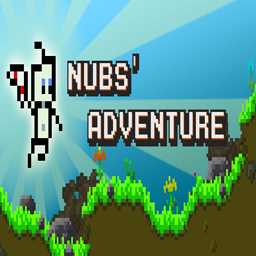

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(norm_img_vecs, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


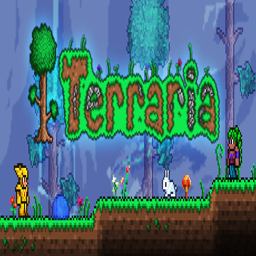

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 918170, title: Curiosity, Score: 0.543992280960083
선택된 게임의 content: A simple world where the player is able to change things that are not supposed to be changed. Welcome to Curiosity, the game where you can hack. Try out different hacks, get creative, entertain yourself! And hey, maybe you'll find a secret or two along the way!
선택된 게임의 genres: ['Free to Play', 'Casual', 'Indie']


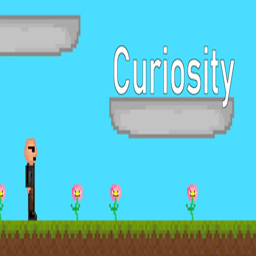

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.5376862287521362
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


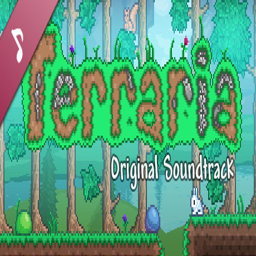

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 1247170, title: Alien Cat, Score: 0.5264899134635925
선택된 게임의 content: Save the Universe with the Alien-Cat in this brand new puzzle-platformer game! Jump on your enemies heads, push the boxes and walk on the ceiling.
선택된 게임의 genres: ['Indie', 'Casual', 'Short', 'Family Friendly', 'Difficult', 'Adventure', 'Platformer']


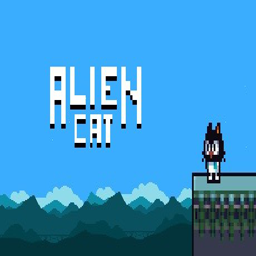

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 645410, title: Ominous Tales: The Forsaken Isle, Score: 0.4809201955795288
선택된 게임의 content: There’s an island 30 miles off the coast of England that the locals call 'The Forsaken Isle'. It is said to be home to ghosts, necromancers and dangerous man-eating creatures! Travel to the island to confront the evil warlock, a vicious pack of wolves and dark forces in order to escape with your life!
선택된 게임의 genres: ['Adventure', 'Indie', 'Casual', 'Hidden Object']


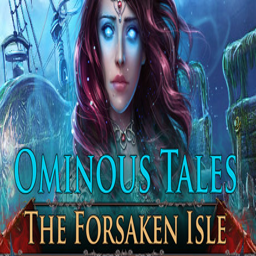

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 401280, title: Nubs' Adventure, Score: 0.477771133184433
선택된 게임의 content: Nubs' Adventure is platforming action and exploration combined with an intriguing story and a vast world to explore!
선택된 게임의 genres: ['Action', 'Adventure', 'Indie', 'Platformer', 'Pixel Graphics']


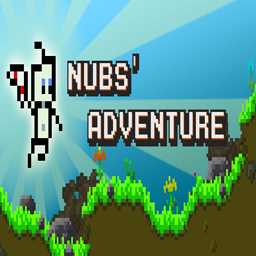

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(standard_img_vecs, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


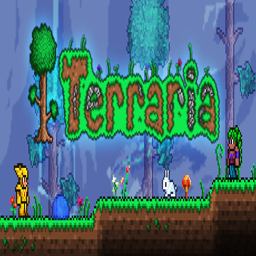

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 1201840, title: MAN STANDING, Score: 0.9963276982307434
선택된 게임의 content: The ALFINA GAMERS team together with ALFINA WORLD GAME PUBLISHING are pleased to present a unique game experience. Get ready to challenge nature, incredible dangers, serious enemies, and most importantly - yourself.
선택된 게임의 genres: ['Adventure', 'Action', 'Simulation', 'Indie', 'Philosophical', 'Walking Simulator', 'Story Rich', 'Atmospheric', 'Parody ', 'Violent', 'Gore', 'Memes', 'Great Soundtrack', 'Exploration', 'Psychological Horror', 'Mystery', 'Anime', 'Hentai', 'Sexual Content']


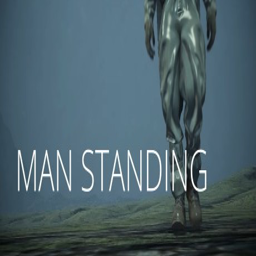

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.9961910247802734
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


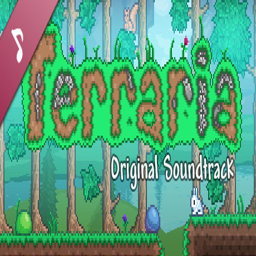

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 750850, title: The Dream Collector, Score: 0.9956910014152527
선택된 게임의 content: Discover what happens to our abandoned dreams in "The Dream Collector," a VR film that follows the story of an old man and his dog, who collect broken dreams and try to fix them.
선택된 게임의 genres: ['Indie', 'Casual', 'VR']


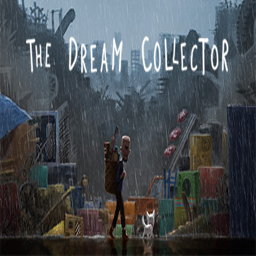

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 512032, title: Sid Meier's Civilization® VI: Vikings Scenario Pack, Score: 0.9955999255180359
선택된 게임의 content: This content requires the base game Sid Meier’s Civilization® VI on Steam in order to play.
선택된 게임의 genres: ['Strategy']


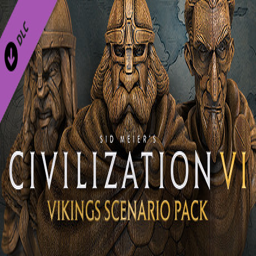

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 842290, title: ArcBall 2, Score: 0.9955447912216187
선택된 게임의 content: ArcBall 2 - second part of "ArcBall" arcanoid game.This is simple and casual arcanoid-like game. Interesting levels and nice retro-graphics are waiting you!
선택된 게임의 genres: ['Casual', 'Indie', 'Simulation']


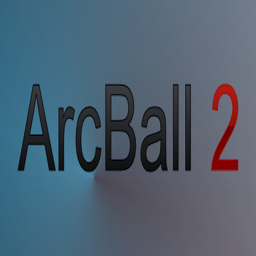

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(min_max_img_vecs, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


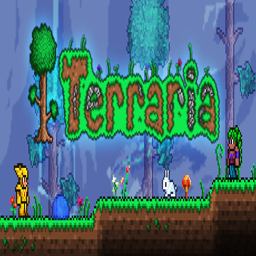

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 918170, title: Curiosity, Score: 0.716498613357544
선택된 게임의 content: A simple world where the player is able to change things that are not supposed to be changed. Welcome to Curiosity, the game where you can hack. Try out different hacks, get creative, entertain yourself! And hey, maybe you'll find a secret or two along the way!
선택된 게임의 genres: ['Free to Play', 'Casual', 'Indie']


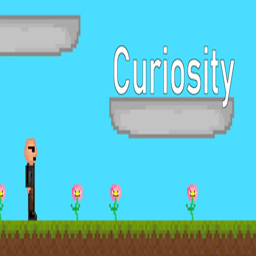

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1247170, title: Alien Cat, Score: 0.711576521396637
선택된 게임의 content: Save the Universe with the Alien-Cat in this brand new puzzle-platformer game! Jump on your enemies heads, push the boxes and walk on the ceiling.
선택된 게임의 genres: ['Indie', 'Casual', 'Short', 'Family Friendly', 'Difficult', 'Adventure', 'Platformer']


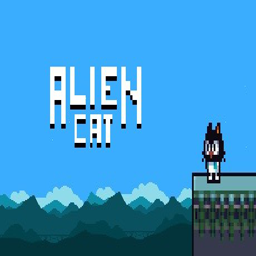

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.6893984079360962
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


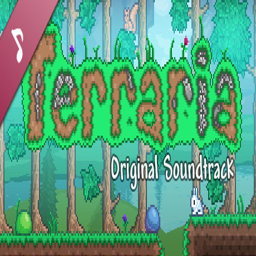

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1201840, title: MAN STANDING, Score: 0.6532325148582458
선택된 게임의 content: The ALFINA GAMERS team together with ALFINA WORLD GAME PUBLISHING are pleased to present a unique game experience. Get ready to challenge nature, incredible dangers, serious enemies, and most importantly - yourself.
선택된 게임의 genres: ['Adventure', 'Action', 'Simulation', 'Indie', 'Philosophical', 'Walking Simulator', 'Story Rich', 'Atmospheric', 'Parody ', 'Violent', 'Gore', 'Memes', 'Great Soundtrack', 'Exploration', 'Psychological Horror', 'Mystery', 'Anime', 'Hentai', 'Sexual Content']


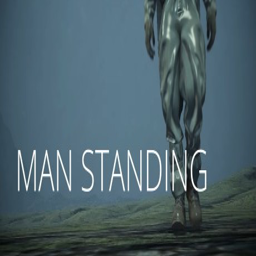

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 401280, title: Nubs' Adventure, Score: 0.641440212726593
선택된 게임의 content: Nubs' Adventure is platforming action and exploration combined with an intriguing story and a vast world to explore!
선택된 게임의 genres: ['Action', 'Adventure', 'Indie', 'Platformer', 'Pixel Graphics']


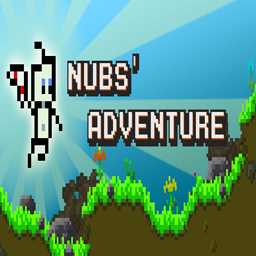

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(img_vecs, 1215, top = 5)

## 장르

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


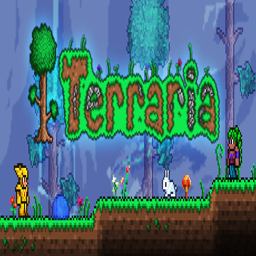

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 211820, title: Starbound, Score: 0.7735928893089294
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


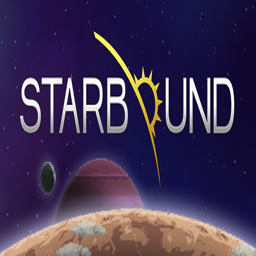

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1169040, title: Necesse, Score: 0.7723995447158813
선택된 게임의 content: Necesse is a top-down sandbox action-adventure game in a procedural generated world. Progress your characters gear and settlement through fighting, mining, exploring, crafting, trading and more!
선택된 게임의 genres: ['Indie', 'Action', 'Adventure', 'Early Access', 'Survival', 'Sandbox', 'Pixel Graphics', 'Colony Sim', 'Crafting', 'Action-Adventure', 'Multiplayer', '2D', 'Building', 'Open World Survival Craft', 'Open World', 'Co-op', 'Online Co-Op', 'Replay Value', 'Singleplayer', 'RPG']


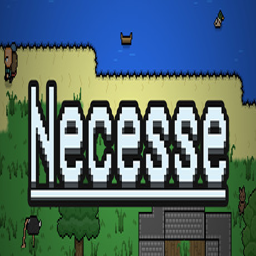

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 266170, title: Windforge, Score: 0.736497700214386
선택된 게임의 content: WindForge is a side-scrolling block-building game where you explore hostile skies in an ever-changing Steampunk world. Everything you see can be created or destroyed, creating an RPG without barriers that rewards creative problem solving and improvisation.
선택된 게임의 genres: ['Indie', 'RPG', 'Action', 'Steampunk', 'Sandbox', 'Open World Survival Craft', 'Crafting', '2D', 'Open World', 'Building', 'Singleplayer', 'Platformer', 'Side Scroller', 'Survival', 'Adventure', 'Pixel Graphics']


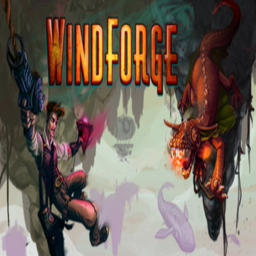

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1276660, title: Tinkertown, Score: 0.7001688480377197
선택된 게임의 content: Gather your friends and come to Tinkertown - A refreshing new Multiplayer Sandbox Experience! Explore magical places filled with loot, danger, and creativity.
선택된 게임의 genres: ['Adventure', 'RPG', 'Indie', 'Survival', 'Pixel Graphics', 'Multiplayer', 'Crafting', 'Sandbox', 'Open World', 'Building', 'Early Access', 'Open World Survival Craft', 'Online Co-Op', 'Exploration', '2D', 'Co-op', 'Dungeon Crawler', 'Singleplayer', 'Atmospheric', 'Great Soundtrack']


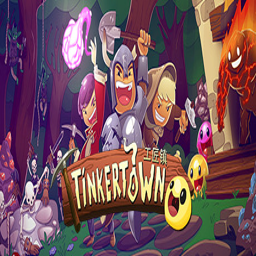

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 238240, title: Edge of Space, Score: 0.6978279948234558
선택된 게임의 content: Suit up as an operative of the Ark Corporation, sent to the farthest reaches of the universe in search of habitable planets to terraform. However, after the long space journey you awaken from cryosleep to find that your ship has gone way off course and is disabled near a strange new world.
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Indie', 'Adventure', '2D', 'Action', 'Crafting', 'Space', 'Sci-fi', 'RPG', 'Survival', 'Multiplayer', 'Open World', 'Platformer', 'Co-op', 'Building', 'Early Access', 'Pixel Graphics', 'Exploration', 'Side Scroller']


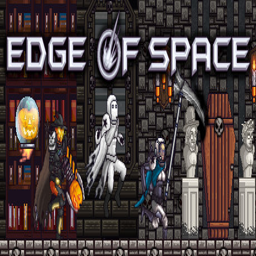

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(norm_gen_vecs, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


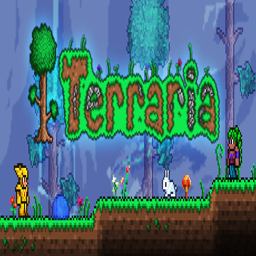

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 211820, title: Starbound, Score: 0.7524588108062744
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


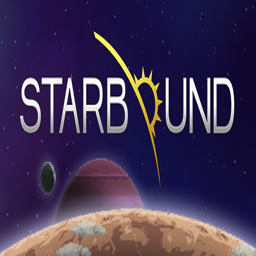

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1169040, title: Necesse, Score: 0.7515126466751099
선택된 게임의 content: Necesse is a top-down sandbox action-adventure game in a procedural generated world. Progress your characters gear and settlement through fighting, mining, exploring, crafting, trading and more!
선택된 게임의 genres: ['Indie', 'Action', 'Adventure', 'Early Access', 'Survival', 'Sandbox', 'Pixel Graphics', 'Colony Sim', 'Crafting', 'Action-Adventure', 'Multiplayer', '2D', 'Building', 'Open World Survival Craft', 'Open World', 'Co-op', 'Online Co-Op', 'Replay Value', 'Singleplayer', 'RPG']


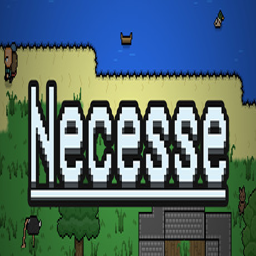

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 266170, title: Windforge, Score: 0.6997765898704529
선택된 게임의 content: WindForge is a side-scrolling block-building game where you explore hostile skies in an ever-changing Steampunk world. Everything you see can be created or destroyed, creating an RPG without barriers that rewards creative problem solving and improvisation.
선택된 게임의 genres: ['Indie', 'RPG', 'Action', 'Steampunk', 'Sandbox', 'Open World Survival Craft', 'Crafting', '2D', 'Open World', 'Building', 'Singleplayer', 'Platformer', 'Side Scroller', 'Survival', 'Adventure', 'Pixel Graphics']


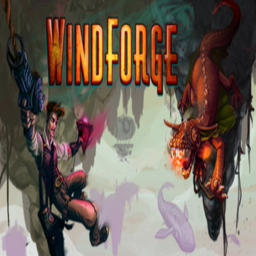

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1276660, title: Tinkertown, Score: 0.6750248074531555
선택된 게임의 content: Gather your friends and come to Tinkertown - A refreshing new Multiplayer Sandbox Experience! Explore magical places filled with loot, danger, and creativity.
선택된 게임의 genres: ['Adventure', 'RPG', 'Indie', 'Survival', 'Pixel Graphics', 'Multiplayer', 'Crafting', 'Sandbox', 'Open World', 'Building', 'Early Access', 'Open World Survival Craft', 'Online Co-Op', 'Exploration', '2D', 'Co-op', 'Dungeon Crawler', 'Singleplayer', 'Atmospheric', 'Great Soundtrack']


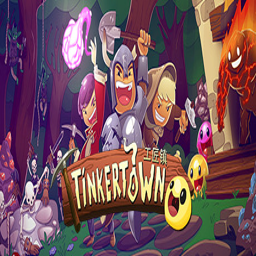

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 238240, title: Edge of Space, Score: 0.6577292680740356
선택된 게임의 content: Suit up as an operative of the Ark Corporation, sent to the farthest reaches of the universe in search of habitable planets to terraform. However, after the long space journey you awaken from cryosleep to find that your ship has gone way off course and is disabled near a strange new world.
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Indie', 'Adventure', '2D', 'Action', 'Crafting', 'Space', 'Sci-fi', 'RPG', 'Survival', 'Multiplayer', 'Open World', 'Platformer', 'Co-op', 'Building', 'Early Access', 'Pixel Graphics', 'Exploration', 'Side Scroller']


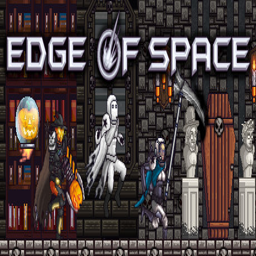

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(standard_gen_vecs, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


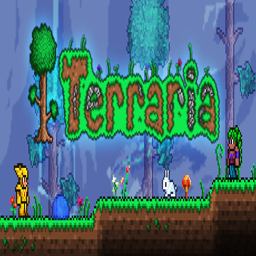

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 1169040, title: Necesse, Score: 0.9853613972663879
선택된 게임의 content: Necesse is a top-down sandbox action-adventure game in a procedural generated world. Progress your characters gear and settlement through fighting, mining, exploring, crafting, trading and more!
선택된 게임의 genres: ['Indie', 'Action', 'Adventure', 'Early Access', 'Survival', 'Sandbox', 'Pixel Graphics', 'Colony Sim', 'Crafting', 'Action-Adventure', 'Multiplayer', '2D', 'Building', 'Open World Survival Craft', 'Open World', 'Co-op', 'Online Co-Op', 'Replay Value', 'Singleplayer', 'RPG']


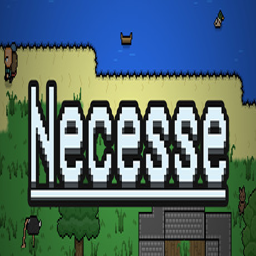

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 211820, title: Starbound, Score: 0.9849119186401367
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


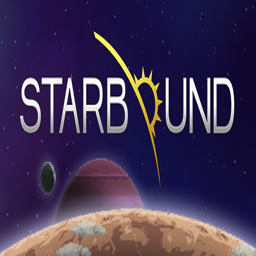

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 266170, title: Windforge, Score: 0.984878420829773
선택된 게임의 content: WindForge is a side-scrolling block-building game where you explore hostile skies in an ever-changing Steampunk world. Everything you see can be created or destroyed, creating an RPG without barriers that rewards creative problem solving and improvisation.
선택된 게임의 genres: ['Indie', 'RPG', 'Action', 'Steampunk', 'Sandbox', 'Open World Survival Craft', 'Crafting', '2D', 'Open World', 'Building', 'Singleplayer', 'Platformer', 'Side Scroller', 'Survival', 'Adventure', 'Pixel Graphics']


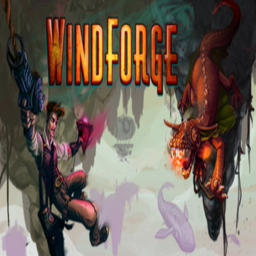

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 490280, title: Realms of Magic, Score: 0.982668936252594
선택된 게임의 content: Conquer the Realms of Magic. A 2D Action RPG in an epic fantasy setting that gives you a great level of freedom and customization. Explore the open world of the Old Kingdom as a knight or a wizard. Or build a house, plant fruits, invest in livestock… become a farmer… that also sounds nice!
선택된 게임의 genres: ['RPG', 'Adventure', 'Open World Survival Craft', 'Indie', 'Open World', 'Action', 'Sandbox', 'Survival', '2D', 'Early Access', 'Pixel Graphics', 'Platformer', 'Crafting']


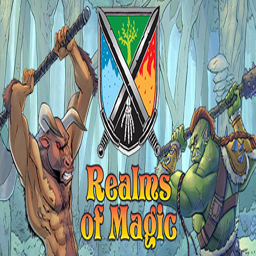

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 1276660, title: Tinkertown, Score: 0.9819949865341187
선택된 게임의 content: Gather your friends and come to Tinkertown - A refreshing new Multiplayer Sandbox Experience! Explore magical places filled with loot, danger, and creativity.
선택된 게임의 genres: ['Adventure', 'RPG', 'Indie', 'Survival', 'Pixel Graphics', 'Multiplayer', 'Crafting', 'Sandbox', 'Open World', 'Building', 'Early Access', 'Open World Survival Craft', 'Online Co-Op', 'Exploration', '2D', 'Co-op', 'Dungeon Crawler', 'Singleplayer', 'Atmospheric', 'Great Soundtrack']


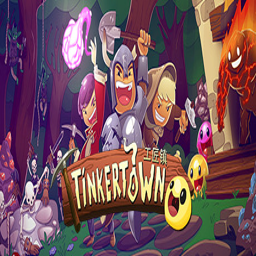

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(min_max_gen_vecs, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


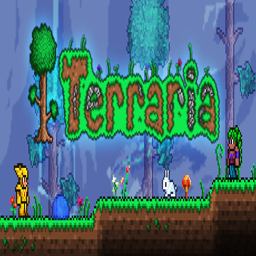

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 211820, title: Starbound, Score: 0.7735928893089294
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


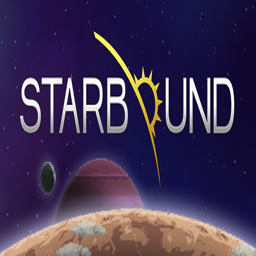

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1169040, title: Necesse, Score: 0.772399365901947
선택된 게임의 content: Necesse is a top-down sandbox action-adventure game in a procedural generated world. Progress your characters gear and settlement through fighting, mining, exploring, crafting, trading and more!
선택된 게임의 genres: ['Indie', 'Action', 'Adventure', 'Early Access', 'Survival', 'Sandbox', 'Pixel Graphics', 'Colony Sim', 'Crafting', 'Action-Adventure', 'Multiplayer', '2D', 'Building', 'Open World Survival Craft', 'Open World', 'Co-op', 'Online Co-Op', 'Replay Value', 'Singleplayer', 'RPG']


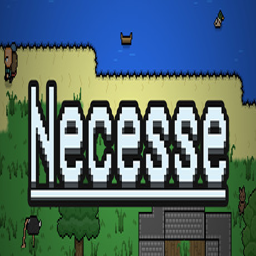

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 266170, title: Windforge, Score: 0.7364976406097412
선택된 게임의 content: WindForge is a side-scrolling block-building game where you explore hostile skies in an ever-changing Steampunk world. Everything you see can be created or destroyed, creating an RPG without barriers that rewards creative problem solving and improvisation.
선택된 게임의 genres: ['Indie', 'RPG', 'Action', 'Steampunk', 'Sandbox', 'Open World Survival Craft', 'Crafting', '2D', 'Open World', 'Building', 'Singleplayer', 'Platformer', 'Side Scroller', 'Survival', 'Adventure', 'Pixel Graphics']


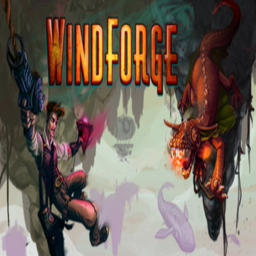

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1276660, title: Tinkertown, Score: 0.700168788433075
선택된 게임의 content: Gather your friends and come to Tinkertown - A refreshing new Multiplayer Sandbox Experience! Explore magical places filled with loot, danger, and creativity.
선택된 게임의 genres: ['Adventure', 'RPG', 'Indie', 'Survival', 'Pixel Graphics', 'Multiplayer', 'Crafting', 'Sandbox', 'Open World', 'Building', 'Early Access', 'Open World Survival Craft', 'Online Co-Op', 'Exploration', '2D', 'Co-op', 'Dungeon Crawler', 'Singleplayer', 'Atmospheric', 'Great Soundtrack']


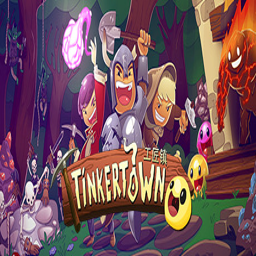

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 238240, title: Edge of Space, Score: 0.697827935218811
선택된 게임의 content: Suit up as an operative of the Ark Corporation, sent to the farthest reaches of the universe in search of habitable planets to terraform. However, after the long space journey you awaken from cryosleep to find that your ship has gone way off course and is disabled near a strange new world.
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Indie', 'Adventure', '2D', 'Action', 'Crafting', 'Space', 'Sci-fi', 'RPG', 'Survival', 'Multiplayer', 'Open World', 'Platformer', 'Co-op', 'Building', 'Early Access', 'Pixel Graphics', 'Exploration', 'Side Scroller']


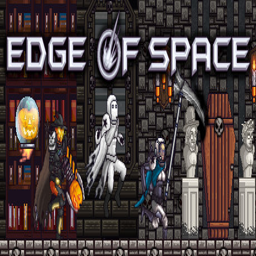

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(gen_vecs, 1215, top = 5)

## 순서

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


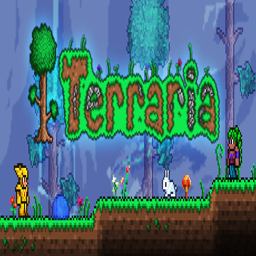

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 4000, title: Garry's Mod, Score: 0.7260212898254395
선택된 게임의 content: Garry's Mod is a physics sandbox. There aren't any predefined aims or goals. We give you the tools and leave you to play.
선택된 게임의 genres: ['Sandbox', 'Multiplayer', 'Funny', 'Moddable', 'Building', 'Comedy', 'Co-op', 'Mod', 'First-Person', 'Physics', 'Simulation', 'Online Co-Op', 'FPS', 'Singleplayer', 'Action', 'Shooter', 'Animation & Modeling', 'Indie', 'Massively Multiplayer', 'Adventure']


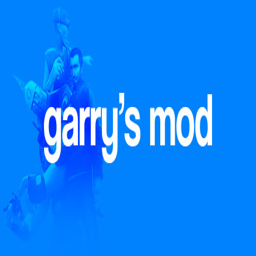

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 211820, title: Starbound, Score: 0.7103440165519714
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


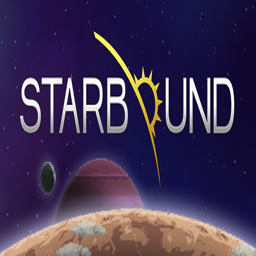

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 72850, title: The Elder Scrolls V: Skyrim, Score: 0.6986970901489258
선택된 게임의 content: EPIC FANTASY REBORN The next chapter in the highly anticipated Elder Scrolls saga arrives from the makers of the 2006 and 2008 Games of the Year, Bethesda Game Studios. Skyrim reimagines and revolutionizes the open-world fantasy epic, bringing to life a complete virtual world open for you to explore any way you choose.
선택된 게임의 genres: ['Open World', 'RPG', 'Fantasy', 'Adventure', 'Moddable', 'Dragons', 'First-Person', 'Action', 'Medieval', 'Singleplayer', 'Magic', 'Story Rich', 'Great Soundtrack', 'Sandbox', 'Lore-Rich', 'Atmospheric', 'Character Customization', 'Action RPG', 'Third Person', 'Epic']


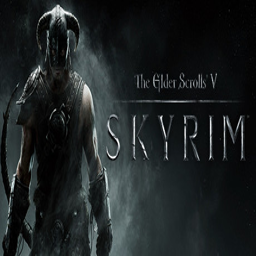

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 440, title: Team Fortress 2, Score: 0.6972209215164185
선택된 게임의 content: Nine distinct classes provide a broad range of tactical abilities and personalities. Constantly updated with new game modes, maps, equipment and, most importantly, hats!
선택된 게임의 genres: ['Free to Play', 'Hero Shooter', 'Multiplayer', 'FPS', 'Shooter', 'Action', 'Class-Based', 'Team-Based', 'Funny', 'First-Person', 'Online Co-Op', 'Competitive', 'Cartoony', 'Trading', 'Co-op', 'Comedy', 'Robots', 'Tactical', 'Cartoon', 'Crafting']


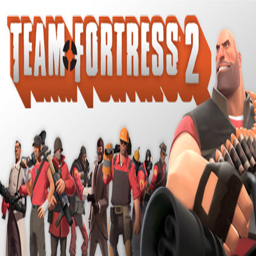

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 413150, title: Stardew Valley, Score: 0.6932065486907959
선택된 게임의 content: You've inherited your grandfather's old farm plot in Stardew Valley. Armed with hand-me-down tools and a few coins, you set out to begin your new life. Can you learn to live off the land and turn these overgrown fields into a thriving home?
선택된 게임의 genres: ['Farming Sim', 'Life Sim', 'RPG', 'Pixel Graphics', 'Agriculture', 'Multiplayer', 'Simulation', 'Relaxing', 'Crafting', 'Sandbox', 'Indie', 'Building', 'Singleplayer', 'Casual', 'Open World', '2D', 'Great Soundtrack', 'Cute', 'Dating Sim', 'Fishing']


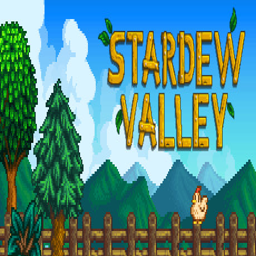

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(norm_seq_vecs, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


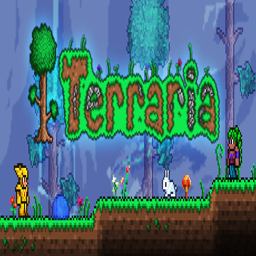

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 4000, title: Garry's Mod, Score: 0.6803373098373413
선택된 게임의 content: Garry's Mod is a physics sandbox. There aren't any predefined aims or goals. We give you the tools and leave you to play.
선택된 게임의 genres: ['Sandbox', 'Multiplayer', 'Funny', 'Moddable', 'Building', 'Comedy', 'Co-op', 'Mod', 'First-Person', 'Physics', 'Simulation', 'Online Co-Op', 'FPS', 'Singleplayer', 'Action', 'Shooter', 'Animation & Modeling', 'Indie', 'Massively Multiplayer', 'Adventure']


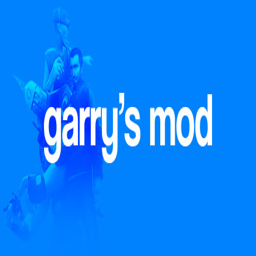

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 211820, title: Starbound, Score: 0.6425159573554993
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


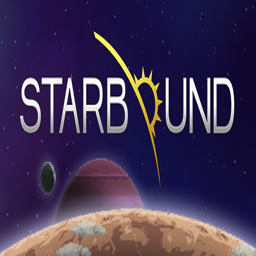

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 440, title: Team Fortress 2, Score: 0.6415080428123474
선택된 게임의 content: Nine distinct classes provide a broad range of tactical abilities and personalities. Constantly updated with new game modes, maps, equipment and, most importantly, hats!
선택된 게임의 genres: ['Free to Play', 'Hero Shooter', 'Multiplayer', 'FPS', 'Shooter', 'Action', 'Class-Based', 'Team-Based', 'Funny', 'First-Person', 'Online Co-Op', 'Competitive', 'Cartoony', 'Trading', 'Co-op', 'Comedy', 'Robots', 'Tactical', 'Cartoon', 'Crafting']


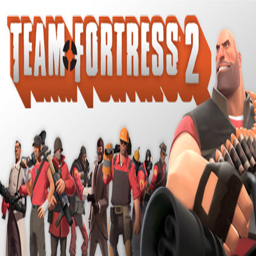

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 413150, title: Stardew Valley, Score: 0.638727605342865
선택된 게임의 content: You've inherited your grandfather's old farm plot in Stardew Valley. Armed with hand-me-down tools and a few coins, you set out to begin your new life. Can you learn to live off the land and turn these overgrown fields into a thriving home?
선택된 게임의 genres: ['Farming Sim', 'Life Sim', 'RPG', 'Pixel Graphics', 'Agriculture', 'Multiplayer', 'Simulation', 'Relaxing', 'Crafting', 'Sandbox', 'Indie', 'Building', 'Singleplayer', 'Casual', 'Open World', '2D', 'Great Soundtrack', 'Cute', 'Dating Sim', 'Fishing']


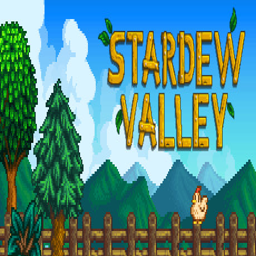

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 72850, title: The Elder Scrolls V: Skyrim, Score: 0.6376494765281677
선택된 게임의 content: EPIC FANTASY REBORN The next chapter in the highly anticipated Elder Scrolls saga arrives from the makers of the 2006 and 2008 Games of the Year, Bethesda Game Studios. Skyrim reimagines and revolutionizes the open-world fantasy epic, bringing to life a complete virtual world open for you to explore any way you choose.
선택된 게임의 genres: ['Open World', 'RPG', 'Fantasy', 'Adventure', 'Moddable', 'Dragons', 'First-Person', 'Action', 'Medieval', 'Singleplayer', 'Magic', 'Story Rich', 'Great Soundtrack', 'Sandbox', 'Lore-Rich', 'Atmospheric', 'Character Customization', 'Action RPG', 'Third Person', 'Epic']


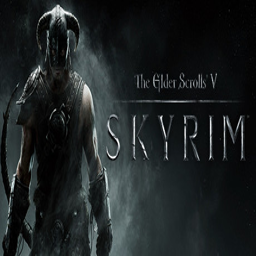

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(standard_seq_vecs, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


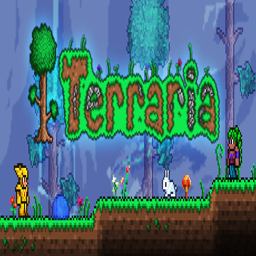

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 72850, title: The Elder Scrolls V: Skyrim, Score: 0.9974650740623474
선택된 게임의 content: EPIC FANTASY REBORN The next chapter in the highly anticipated Elder Scrolls saga arrives from the makers of the 2006 and 2008 Games of the Year, Bethesda Game Studios. Skyrim reimagines and revolutionizes the open-world fantasy epic, bringing to life a complete virtual world open for you to explore any way you choose.
선택된 게임의 genres: ['Open World', 'RPG', 'Fantasy', 'Adventure', 'Moddable', 'Dragons', 'First-Person', 'Action', 'Medieval', 'Singleplayer', 'Magic', 'Story Rich', 'Great Soundtrack', 'Sandbox', 'Lore-Rich', 'Atmospheric', 'Character Customization', 'Action RPG', 'Third Person', 'Epic']


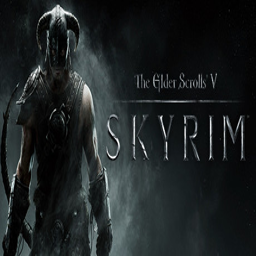

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 49520, title: Borderlands 2, Score: 0.9973713159561157
선택된 게임의 content: The Ultimate Vault Hunter’s Upgrade lets you get the most out of the Borderlands 2 experience.
선택된 게임의 genres: ['Loot', 'Shooter', 'Action', 'Multiplayer', 'Co-op', 'Looter Shooter', 'FPS', 'RPG', 'First-Person', 'Funny', 'Comedy', 'Open World', 'Combat', 'Online Co-Op', 'Adventure', 'Action RPG', 'Dark Humor', 'Memes', 'Singleplayer', 'Sci-fi']


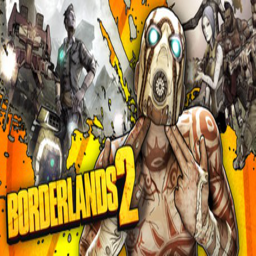

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 440, title: Team Fortress 2, Score: 0.997363269329071
선택된 게임의 content: Nine distinct classes provide a broad range of tactical abilities and personalities. Constantly updated with new game modes, maps, equipment and, most importantly, hats!
선택된 게임의 genres: ['Free to Play', 'Hero Shooter', 'Multiplayer', 'FPS', 'Shooter', 'Action', 'Class-Based', 'Team-Based', 'Funny', 'First-Person', 'Online Co-Op', 'Competitive', 'Cartoony', 'Trading', 'Co-op', 'Comedy', 'Robots', 'Tactical', 'Cartoon', 'Crafting']


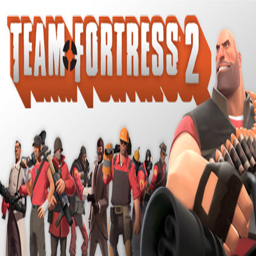

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 413150, title: Stardew Valley, Score: 0.997273325920105
선택된 게임의 content: You've inherited your grandfather's old farm plot in Stardew Valley. Armed with hand-me-down tools and a few coins, you set out to begin your new life. Can you learn to live off the land and turn these overgrown fields into a thriving home?
선택된 게임의 genres: ['Farming Sim', 'Life Sim', 'RPG', 'Pixel Graphics', 'Agriculture', 'Multiplayer', 'Simulation', 'Relaxing', 'Crafting', 'Sandbox', 'Indie', 'Building', 'Singleplayer', 'Casual', 'Open World', '2D', 'Great Soundtrack', 'Cute', 'Dating Sim', 'Fishing']


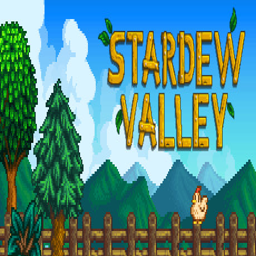

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 4000, title: Garry's Mod, Score: 0.9972269535064697
선택된 게임의 content: Garry's Mod is a physics sandbox. There aren't any predefined aims or goals. We give you the tools and leave you to play.
선택된 게임의 genres: ['Sandbox', 'Multiplayer', 'Funny', 'Moddable', 'Building', 'Comedy', 'Co-op', 'Mod', 'First-Person', 'Physics', 'Simulation', 'Online Co-Op', 'FPS', 'Singleplayer', 'Action', 'Shooter', 'Animation & Modeling', 'Indie', 'Massively Multiplayer', 'Adventure']


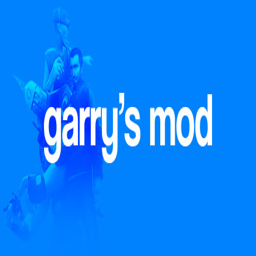

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(min_max_seq_vecs, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


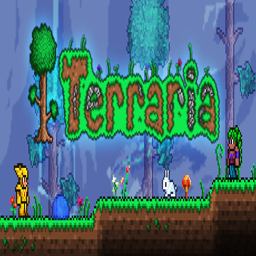

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 4000, title: Garry's Mod, Score: 0.7260211706161499
선택된 게임의 content: Garry's Mod is a physics sandbox. There aren't any predefined aims or goals. We give you the tools and leave you to play.
선택된 게임의 genres: ['Sandbox', 'Multiplayer', 'Funny', 'Moddable', 'Building', 'Comedy', 'Co-op', 'Mod', 'First-Person', 'Physics', 'Simulation', 'Online Co-Op', 'FPS', 'Singleplayer', 'Action', 'Shooter', 'Animation & Modeling', 'Indie', 'Massively Multiplayer', 'Adventure']


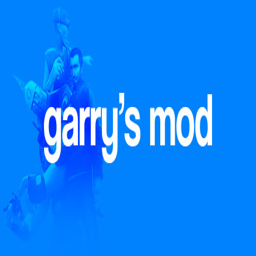

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 211820, title: Starbound, Score: 0.7103438973426819
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


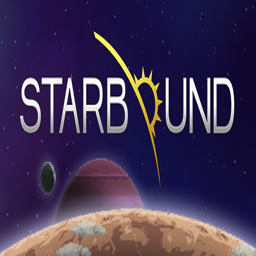

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 72850, title: The Elder Scrolls V: Skyrim, Score: 0.6986969709396362
선택된 게임의 content: EPIC FANTASY REBORN The next chapter in the highly anticipated Elder Scrolls saga arrives from the makers of the 2006 and 2008 Games of the Year, Bethesda Game Studios. Skyrim reimagines and revolutionizes the open-world fantasy epic, bringing to life a complete virtual world open for you to explore any way you choose.
선택된 게임의 genres: ['Open World', 'RPG', 'Fantasy', 'Adventure', 'Moddable', 'Dragons', 'First-Person', 'Action', 'Medieval', 'Singleplayer', 'Magic', 'Story Rich', 'Great Soundtrack', 'Sandbox', 'Lore-Rich', 'Atmospheric', 'Character Customization', 'Action RPG', 'Third Person', 'Epic']


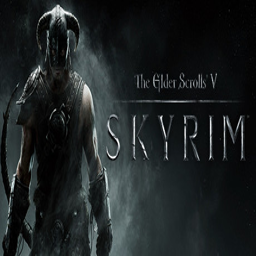

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 440, title: Team Fortress 2, Score: 0.6972208023071289
선택된 게임의 content: Nine distinct classes provide a broad range of tactical abilities and personalities. Constantly updated with new game modes, maps, equipment and, most importantly, hats!
선택된 게임의 genres: ['Free to Play', 'Hero Shooter', 'Multiplayer', 'FPS', 'Shooter', 'Action', 'Class-Based', 'Team-Based', 'Funny', 'First-Person', 'Online Co-Op', 'Competitive', 'Cartoony', 'Trading', 'Co-op', 'Comedy', 'Robots', 'Tactical', 'Cartoon', 'Crafting']


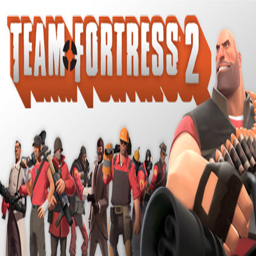

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 413150, title: Stardew Valley, Score: 0.6932065486907959
선택된 게임의 content: You've inherited your grandfather's old farm plot in Stardew Valley. Armed with hand-me-down tools and a few coins, you set out to begin your new life. Can you learn to live off the land and turn these overgrown fields into a thriving home?
선택된 게임의 genres: ['Farming Sim', 'Life Sim', 'RPG', 'Pixel Graphics', 'Agriculture', 'Multiplayer', 'Simulation', 'Relaxing', 'Crafting', 'Sandbox', 'Indie', 'Building', 'Singleplayer', 'Casual', 'Open World', '2D', 'Great Soundtrack', 'Cute', 'Dating Sim', 'Fishing']


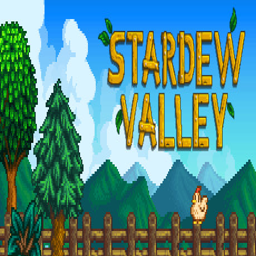

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(seq_vecs, 1215, top = 5)

## 이미지 + 장르

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


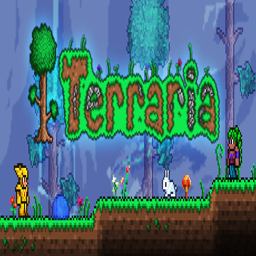

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.6105406284332275
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


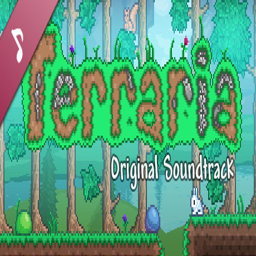

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 327860, title: Salt, Score: 0.584990382194519
선택된 게임의 content: Salt is an open world exploration game where you sail from island to island looking for loot and new discoveries! Relax and explore at your own pace, picking a direction and setting sail across a vast ocean filled with quests, merchants, ruins, pirates, and other mysterious places.
선택된 게임의 genres: ['Open World Survival Craft', 'Open World', 'Survival', 'Adventure', 'Crafting', 'Exploration', 'Sandbox', 'Pirates', 'Multiplayer', 'First-Person', 'Singleplayer', 'Indie', 'RPG', 'Action', 'Sailing', 'Naval', 'Procedural Generation', 'Early Access', 'Atmospheric', 'Walking Simulator']


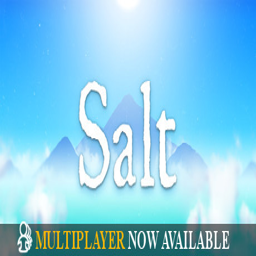

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 327870, title: Salt, Score: 0.584990382194519
선택된 게임의 content: Salt is an open world exploration game where you sail from island to island looking for loot and new discoveries! Relax and explore at your own pace, picking a direction and setting sail across a vast ocean filled with quests, merchants, ruins, pirates, and other mysterious places.
선택된 게임의 genres: ['Open World Survival Craft', 'Open World', 'Survival', 'Adventure', 'Crafting', 'Exploration', 'Sandbox', 'Pirates', 'Multiplayer', 'First-Person', 'Singleplayer', 'Indie', 'RPG', 'Action', 'Sailing', 'Naval', 'Procedural Generation', 'Early Access', 'Atmospheric', 'Walking Simulator']


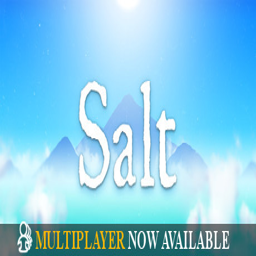

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1169040, title: Necesse, Score: 0.5779810547828674
선택된 게임의 content: Necesse is a top-down sandbox action-adventure game in a procedural generated world. Progress your characters gear and settlement through fighting, mining, exploring, crafting, trading and more!
선택된 게임의 genres: ['Indie', 'Action', 'Adventure', 'Early Access', 'Survival', 'Sandbox', 'Pixel Graphics', 'Colony Sim', 'Crafting', 'Action-Adventure', 'Multiplayer', '2D', 'Building', 'Open World Survival Craft', 'Open World', 'Co-op', 'Online Co-Op', 'Replay Value', 'Singleplayer', 'RPG']


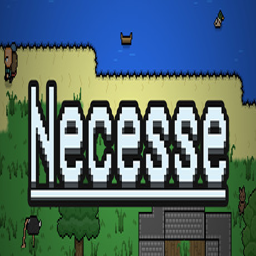

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 1281930, title: tModLoader, Score: 0.5593472123146057
선택된 게임의 content: Dig, Fight, and Build your way through the world of player-created mods on Terraria with tModLoader - this DLC makes modding Terraria a reality!
선택된 게임의 genres: ['Adventure', 'Action', 'Indie', 'RPG', 'Free to Play', 'Mod', 'Sandbox', 'Moddable', 'Multiplayer', 'Building', '2D', 'Pixel Graphics', 'Survival', 'Singleplayer', 'Great Soundtrack', 'Replay Value', 'Co-op', 'Open World Survival Craft', 'Online Co-Op', 'Difficult']


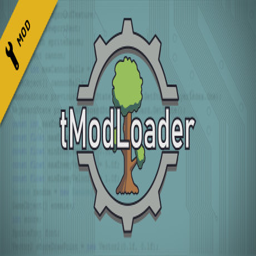

----------------------------------------------------------------------------------------------------


In [ ]:
norm_img_gen2vec = np.concatenate([norm_img_vecs, norm_gen_vecs], axis = 1)
get_sim_game(norm_img_gen2vec, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


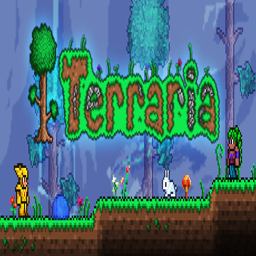

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 1169040, title: Necesse, Score: 0.5398523807525635
선택된 게임의 content: Necesse is a top-down sandbox action-adventure game in a procedural generated world. Progress your characters gear and settlement through fighting, mining, exploring, crafting, trading and more!
선택된 게임의 genres: ['Indie', 'Action', 'Adventure', 'Early Access', 'Survival', 'Sandbox', 'Pixel Graphics', 'Colony Sim', 'Crafting', 'Action-Adventure', 'Multiplayer', '2D', 'Building', 'Open World Survival Craft', 'Open World', 'Co-op', 'Online Co-Op', 'Replay Value', 'Singleplayer', 'RPG']


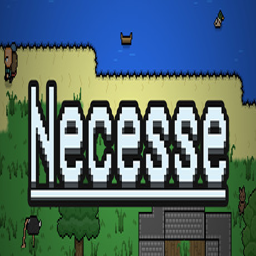

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 892970, title: Valheim, Score: 0.4790216088294983
선택된 게임의 content: A brutal exploration and survival game for 1-10 players, set in a procedurally-generated purgatory inspired by viking culture. Battle, build, and conquer your way to a saga worthy of Odin’s patronage!
선택된 게임의 genres: ['Open World Survival Craft', 'Online Co-Op', 'Survival', 'Open World', 'Crafting', 'Building', 'Exploration', 'Multiplayer', 'Co-op', 'Base Building', 'Mythology', 'Sandbox', 'Adventure', 'Sailing', 'RPG', 'Early Access', 'Action', 'Indie', 'PvP', 'Fishing']


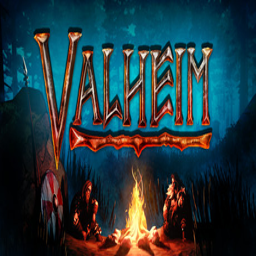

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 1281930, title: tModLoader, Score: 0.474918931722641
선택된 게임의 content: Dig, Fight, and Build your way through the world of player-created mods on Terraria with tModLoader - this DLC makes modding Terraria a reality!
선택된 게임의 genres: ['Adventure', 'Action', 'Indie', 'RPG', 'Free to Play', 'Mod', 'Sandbox', 'Moddable', 'Multiplayer', 'Building', '2D', 'Pixel Graphics', 'Survival', 'Singleplayer', 'Great Soundtrack', 'Replay Value', 'Co-op', 'Open World Survival Craft', 'Online Co-Op', 'Difficult']


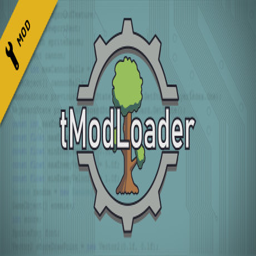

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 211820, title: Starbound, Score: 0.47119536995887756
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


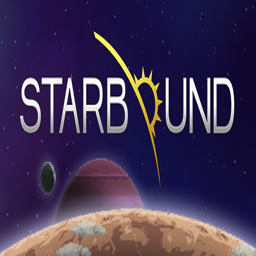

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.47085872292518616
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


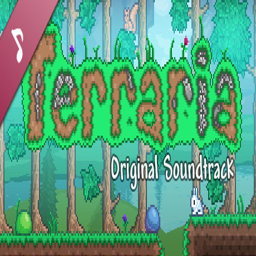

----------------------------------------------------------------------------------------------------


In [ ]:
standard_img_gen2vec = np.concatenate([standard_img_vecs, standard_gen_vecs], axis = 1)
get_sim_game(standard_img_gen2vec, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


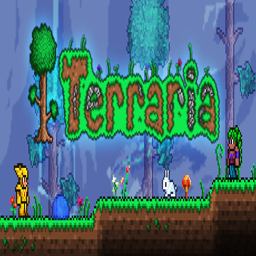

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 1169040, title: Necesse, Score: 0.988750159740448
선택된 게임의 content: Necesse is a top-down sandbox action-adventure game in a procedural generated world. Progress your characters gear and settlement through fighting, mining, exploring, crafting, trading and more!
선택된 게임의 genres: ['Indie', 'Action', 'Adventure', 'Early Access', 'Survival', 'Sandbox', 'Pixel Graphics', 'Colony Sim', 'Crafting', 'Action-Adventure', 'Multiplayer', '2D', 'Building', 'Open World Survival Craft', 'Open World', 'Co-op', 'Online Co-Op', 'Replay Value', 'Singleplayer', 'RPG']


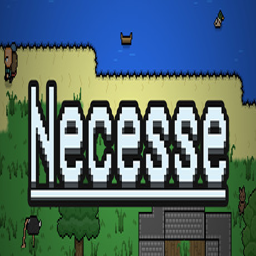

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 490280, title: Realms of Magic, Score: 0.9874961376190186
선택된 게임의 content: Conquer the Realms of Magic. A 2D Action RPG in an epic fantasy setting that gives you a great level of freedom and customization. Explore the open world of the Old Kingdom as a knight or a wizard. Or build a house, plant fruits, invest in livestock… become a farmer… that also sounds nice!
선택된 게임의 genres: ['RPG', 'Adventure', 'Open World Survival Craft', 'Indie', 'Open World', 'Action', 'Sandbox', 'Survival', '2D', 'Early Access', 'Pixel Graphics', 'Platformer', 'Crafting']


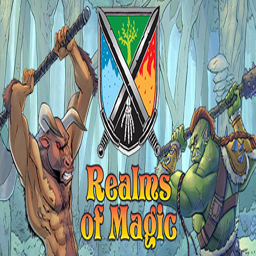

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 892970, title: Valheim, Score: 0.9874547719955444
선택된 게임의 content: A brutal exploration and survival game for 1-10 players, set in a procedurally-generated purgatory inspired by viking culture. Battle, build, and conquer your way to a saga worthy of Odin’s patronage!
선택된 게임의 genres: ['Open World Survival Craft', 'Online Co-Op', 'Survival', 'Open World', 'Crafting', 'Building', 'Exploration', 'Multiplayer', 'Co-op', 'Base Building', 'Mythology', 'Sandbox', 'Adventure', 'Sailing', 'RPG', 'Early Access', 'Action', 'Indie', 'PvP', 'Fishing']


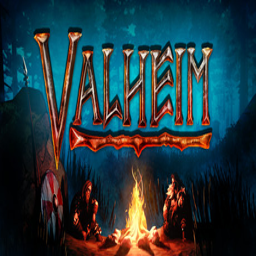

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 211820, title: Starbound, Score: 0.9872318506240845
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


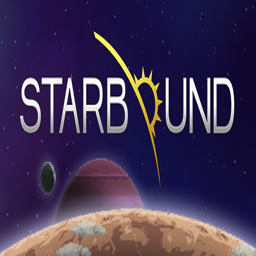

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 1281930, title: tModLoader, Score: 0.9870201349258423
선택된 게임의 content: Dig, Fight, and Build your way through the world of player-created mods on Terraria with tModLoader - this DLC makes modding Terraria a reality!
선택된 게임의 genres: ['Adventure', 'Action', 'Indie', 'RPG', 'Free to Play', 'Mod', 'Sandbox', 'Moddable', 'Multiplayer', 'Building', '2D', 'Pixel Graphics', 'Survival', 'Singleplayer', 'Great Soundtrack', 'Replay Value', 'Co-op', 'Open World Survival Craft', 'Online Co-Op', 'Difficult']


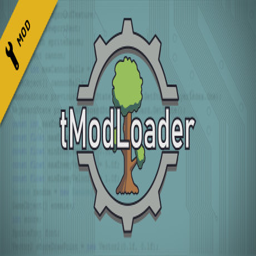

----------------------------------------------------------------------------------------------------


In [ ]:
min_max_img_gen2vec = np.concatenate([min_max_img_vecs, min_max_gen_vecs], axis = 1)
get_sim_game(min_max_img_gen2vec, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


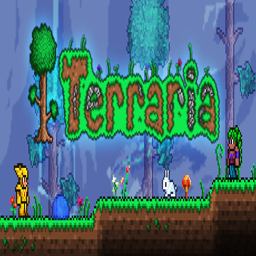

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 918170, title: Curiosity, Score: 0.7164921164512634
선택된 게임의 content: A simple world where the player is able to change things that are not supposed to be changed. Welcome to Curiosity, the game where you can hack. Try out different hacks, get creative, entertain yourself! And hey, maybe you'll find a secret or two along the way!
선택된 게임의 genres: ['Free to Play', 'Casual', 'Indie']


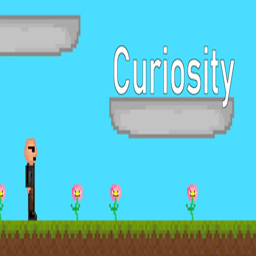

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1247170, title: Alien Cat, Score: 0.711570143699646
선택된 게임의 content: Save the Universe with the Alien-Cat in this brand new puzzle-platformer game! Jump on your enemies heads, push the boxes and walk on the ceiling.
선택된 게임의 genres: ['Indie', 'Casual', 'Short', 'Family Friendly', 'Difficult', 'Adventure', 'Platformer']


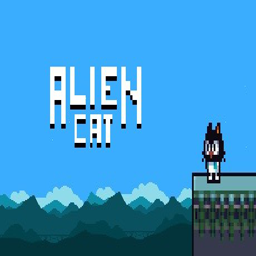

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.6893962025642395
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


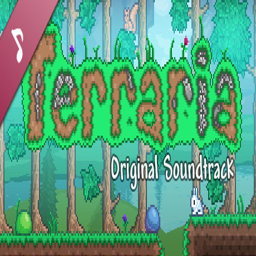

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1201840, title: MAN STANDING, Score: 0.6532182097434998
선택된 게임의 content: The ALFINA GAMERS team together with ALFINA WORLD GAME PUBLISHING are pleased to present a unique game experience. Get ready to challenge nature, incredible dangers, serious enemies, and most importantly - yourself.
선택된 게임의 genres: ['Adventure', 'Action', 'Simulation', 'Indie', 'Philosophical', 'Walking Simulator', 'Story Rich', 'Atmospheric', 'Parody ', 'Violent', 'Gore', 'Memes', 'Great Soundtrack', 'Exploration', 'Psychological Horror', 'Mystery', 'Anime', 'Hentai', 'Sexual Content']


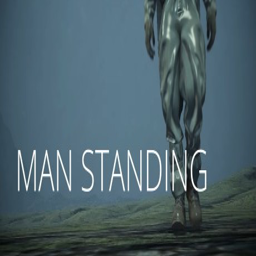

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 401280, title: Nubs' Adventure, Score: 0.6414363980293274
선택된 게임의 content: Nubs' Adventure is platforming action and exploration combined with an intriguing story and a vast world to explore!
선택된 게임의 genres: ['Action', 'Adventure', 'Indie', 'Platformer', 'Pixel Graphics']


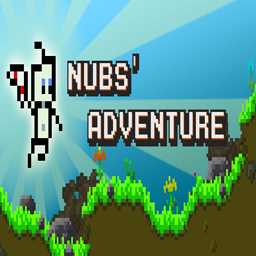

----------------------------------------------------------------------------------------------------


In [ ]:
img_gen2vec = np.concatenate([img_vecs, gen_vecs], axis = 1)
get_sim_game(img_gen2vec, 1215, top = 5)

## 이미지 + 순서

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


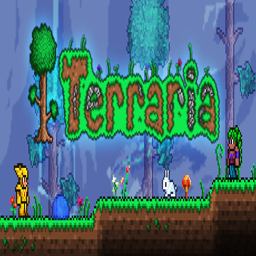

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 4000, title: Garry's Mod, Score: 0.5874627828598022
선택된 게임의 content: Garry's Mod is a physics sandbox. There aren't any predefined aims or goals. We give you the tools and leave you to play.
선택된 게임의 genres: ['Sandbox', 'Multiplayer', 'Funny', 'Moddable', 'Building', 'Comedy', 'Co-op', 'Mod', 'First-Person', 'Physics', 'Simulation', 'Online Co-Op', 'FPS', 'Singleplayer', 'Action', 'Shooter', 'Animation & Modeling', 'Indie', 'Massively Multiplayer', 'Adventure']


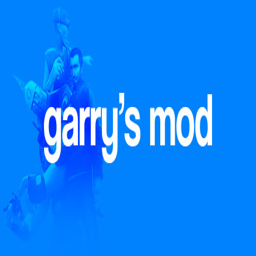

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 264710, title: Subnautica, Score: 0.5492818355560303
선택된 게임의 content: Descend into the depths of an alien underwater world filled with wonder and peril. Craft equipment, pilot submarines and out-smart wildlife to explore lush coral reefs, volcanoes, cave systems, and more - all while trying to survive.
선택된 게임의 genres: ['Open World Survival Craft', 'Survival', 'Open World', 'Exploration', 'Underwater', 'Crafting', 'Base Building', 'Horror', 'Singleplayer', 'Adventure', 'First-Person', 'Sci-fi', 'Sandbox', 'Aliens', 'Atmospheric', 'Survival Horror', 'Action', 'Early Access', 'Indie', 'Multiplayer']


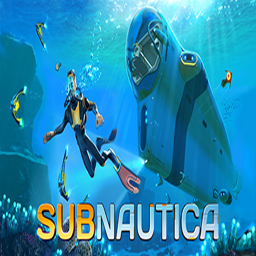

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 413150, title: Stardew Valley, Score: 0.54066002368927
선택된 게임의 content: You've inherited your grandfather's old farm plot in Stardew Valley. Armed with hand-me-down tools and a few coins, you set out to begin your new life. Can you learn to live off the land and turn these overgrown fields into a thriving home?
선택된 게임의 genres: ['Farming Sim', 'Life Sim', 'RPG', 'Pixel Graphics', 'Agriculture', 'Multiplayer', 'Simulation', 'Relaxing', 'Crafting', 'Sandbox', 'Indie', 'Building', 'Singleplayer', 'Casual', 'Open World', '2D', 'Great Soundtrack', 'Cute', 'Dating Sim', 'Fishing']


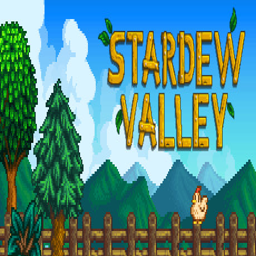

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.5350556373596191
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


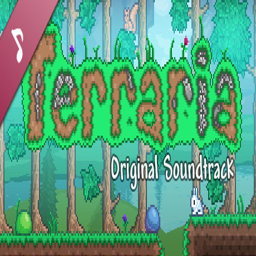

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 582010, title: Monster Hunter: World, Score: 0.5308197736740112
선택된 게임의 content: Welcome to a new world! In Monster Hunter: World, the latest installment in the series, you can enjoy the ultimate hunting experience, using everything at your disposal to hunt monsters in a new world teeming with surprises and excitement.
선택된 게임의 genres: ['Co-op', 'Multiplayer', 'Action', 'Open World', 'RPG', 'Third Person', 'Character Customization', 'Adventure', 'Fantasy', 'Difficult', 'Singleplayer', 'Action RPG', 'Exploration', 'Great Soundtrack', 'Replay Value', 'Atmospheric', 'Hack and Slash', 'JRPG', 'Souls-like', 'MMORPG']


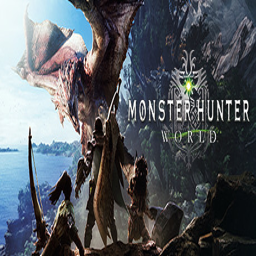

----------------------------------------------------------------------------------------------------


In [ ]:
norm_img_seq2vec = np.concatenate([norm_img_vecs, norm_seq_vecs], axis = 1)
get_sim_game(norm_img_seq2vec, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


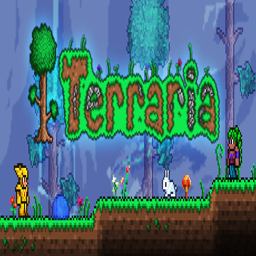

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 582010, title: Monster Hunter: World, Score: 0.37341636419296265
선택된 게임의 content: Welcome to a new world! In Monster Hunter: World, the latest installment in the series, you can enjoy the ultimate hunting experience, using everything at your disposal to hunt monsters in a new world teeming with surprises and excitement.
선택된 게임의 genres: ['Co-op', 'Multiplayer', 'Action', 'Open World', 'RPG', 'Third Person', 'Character Customization', 'Adventure', 'Fantasy', 'Difficult', 'Singleplayer', 'Action RPG', 'Exploration', 'Great Soundtrack', 'Replay Value', 'Atmospheric', 'Hack and Slash', 'JRPG', 'Souls-like', 'MMORPG']


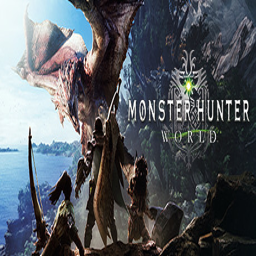

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 3590, title: Plants vs. Zombies GOTY Edition, Score: 0.368886262178421
선택된 게임의 content: Zombies are invading your home, and the only defense is your arsenal of plants! Armed with an alien nursery-worth of zombie-zapping plants like peashooters and cherry bombs, you'll need to think fast and plant faster to stop dozens of types of zombies dead in their tracks.
선택된 게임의 genres: ['Tower Defense', 'Zombies', 'Strategy', 'Singleplayer', 'Casual', 'Comedy', '2D', 'Family Friendly', 'Great Soundtrack', 'Classic', 'Funny', 'Puzzle', 'Cute', 'Indie', 'Addictive', 'Survival', 'Tactical', 'Touch-Friendly', 'Adventure', 'Post-apocalyptic']


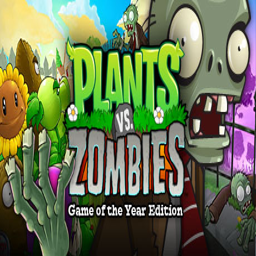

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 264710, title: Subnautica, Score: 0.3647695481777191
선택된 게임의 content: Descend into the depths of an alien underwater world filled with wonder and peril. Craft equipment, pilot submarines and out-smart wildlife to explore lush coral reefs, volcanoes, cave systems, and more - all while trying to survive.
선택된 게임의 genres: ['Open World Survival Craft', 'Survival', 'Open World', 'Exploration', 'Underwater', 'Crafting', 'Base Building', 'Horror', 'Singleplayer', 'Adventure', 'First-Person', 'Sci-fi', 'Sandbox', 'Aliens', 'Atmospheric', 'Survival Horror', 'Action', 'Early Access', 'Indie', 'Multiplayer']


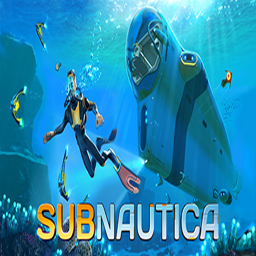

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 238460, title: BattleBlock Theater®, Score: 0.3430088758468628
선택된 게임의 content: Welcome to BattleBlock Theater! You’ve got no where to go but up...on stage. Play single player or co-op to free your friends and save Hatty Hattington! Jump, solve and battle your way through a mysterious theater inhabited by highly technological felines.
선택된 게임의 genres: ['Comedy', 'Co-op', 'Funny', 'Platformer', 'Multiplayer', 'Local Co-Op', 'Adventure', 'Indie', '2D', 'Action', 'Great Soundtrack', 'Online Co-Op', 'Cats', 'Casual', 'Puzzle', 'Level Editor', 'Local Multiplayer', 'Singleplayer', 'Difficult', 'Team-Based']


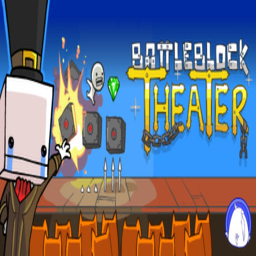

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.32112327218055725
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


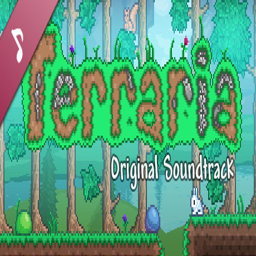

----------------------------------------------------------------------------------------------------


In [ ]:
standard_img_seq2vec = np.concatenate([standard_img_vecs, standard_seq_vecs], axis = 1)
get_sim_game(standard_img_seq2vec, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


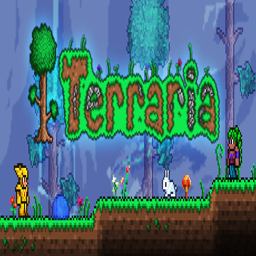

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 72850, title: The Elder Scrolls V: Skyrim, Score: 0.9955840110778809
선택된 게임의 content: EPIC FANTASY REBORN The next chapter in the highly anticipated Elder Scrolls saga arrives from the makers of the 2006 and 2008 Games of the Year, Bethesda Game Studios. Skyrim reimagines and revolutionizes the open-world fantasy epic, bringing to life a complete virtual world open for you to explore any way you choose.
선택된 게임의 genres: ['Open World', 'RPG', 'Fantasy', 'Adventure', 'Moddable', 'Dragons', 'First-Person', 'Action', 'Medieval', 'Singleplayer', 'Magic', 'Story Rich', 'Great Soundtrack', 'Sandbox', 'Lore-Rich', 'Atmospheric', 'Character Customization', 'Action RPG', 'Third Person', 'Epic']


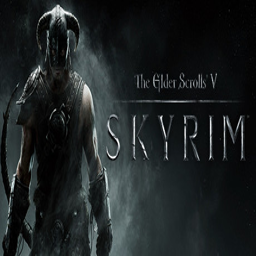

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 252490, title: Rust, Score: 0.9954443573951721
선택된 게임의 content: The only aim in Rust is to survive. Everything wants you to die - the island’s wildlife and other inhabitants, the environment, other survivors. Do whatever it takes to last another night.
선택된 게임의 genres: ['Survival', 'Crafting', 'Multiplayer', 'Open World', 'Open World Survival Craft', 'Building', 'Sandbox', 'PvP', 'Adventure', 'First-Person', 'Action', 'FPS', 'Nudity', 'Co-op', 'Shooter', 'Online Co-Op', 'Indie', 'Early Access', 'Post-apocalyptic', 'Simulation']


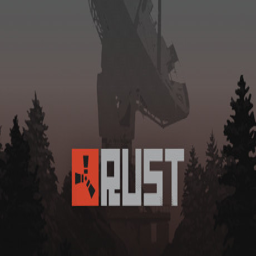

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 230410, title: Warframe, Score: 0.9954387545585632
선택된 게임의 content: Warframe is a cooperative free-to-play third person online action game set in an evolving sci-fi world.
선택된 게임의 genres: ['Free to Play', 'Looter Shooter', 'Action', 'Co-op', 'Multiplayer', 'Third-Person Shooter', 'Sci-fi', 'Ninja', 'Shooter', 'Parkour', 'Space', 'Online Co-Op', 'Futuristic', 'Third Person', 'Massively Multiplayer', 'PvE', 'RPG', 'Hack and Slash', 'Singleplayer', 'FPS']


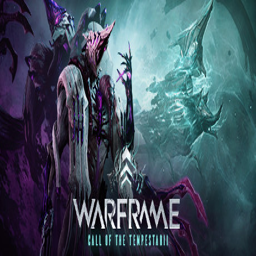

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 248820, title: Risk of Rain, Score: 0.9951974749565125
선택된 게임의 content: Risk of Rain is an action platformer with roguelike elements. With permanent death as a primary feature, players will have to play their best to get as far as possible. Fight on a mysterious planet with randomly spawning enemies and bosses, either alone or with 3 friends in online co-op.
선택된 게임의 genres: ['Action Roguelike', 'Roguelike', 'Indie', 'Platformer', 'Action', 'Pixel Graphics', 'Great Soundtrack', 'Online Co-Op', 'Difficult', 'Perma Death', 'Co-op', '2D', 'Local Co-Op', 'Roguelite', 'Multiplayer', 'RPG', 'Singleplayer', 'Addictive', 'Replay Value', 'Survival']


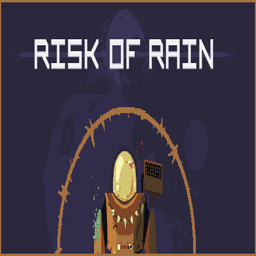

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 489830, title: The Elder Scrolls V: Skyrim Special Edition, Score: 0.9949805736541748
선택된 게임의 content: Winner of more than 200 Game of the Year Awards, Skyrim Special Edition brings the epic fantasy to life in stunning detail. The Special Edition includes the critically acclaimed game and add-ons with all-new features like remastered art and effects, volumetric god rays, dynamic depth of field, screen-space reflections, and more.
선택된 게임의 genres: ['Open World', 'RPG', 'Adventure', 'Singleplayer', 'Fantasy', 'Character Customization', 'Dragons', 'Moddable', 'Story Rich', 'Magic', 'First-Person', 'Action', 'Atmospheric', 'Great Soundtrack', 'Third Person', 'Stealth', 'Classic', 'Remake', 'Female Protagonist', 'Walking Simulator']


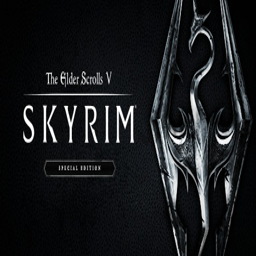

----------------------------------------------------------------------------------------------------


In [ ]:
min_max_img_seq2vec = np.concatenate([min_max_img_vecs, min_max_seq_vecs], axis = 1)
get_sim_game(min_max_img_seq2vec, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


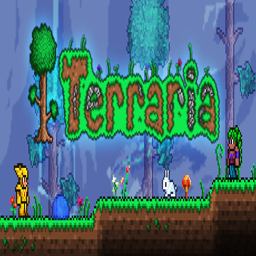

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 918170, title: Curiosity, Score: 0.7164952158927917
선택된 게임의 content: A simple world where the player is able to change things that are not supposed to be changed. Welcome to Curiosity, the game where you can hack. Try out different hacks, get creative, entertain yourself! And hey, maybe you'll find a secret or two along the way!
선택된 게임의 genres: ['Free to Play', 'Casual', 'Indie']


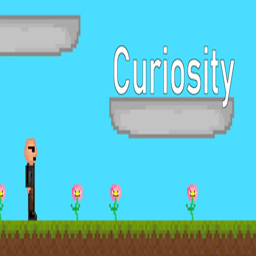

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1247170, title: Alien Cat, Score: 0.711571216583252
선택된 게임의 content: Save the Universe with the Alien-Cat in this brand new puzzle-platformer game! Jump on your enemies heads, push the boxes and walk on the ceiling.
선택된 게임의 genres: ['Indie', 'Casual', 'Short', 'Family Friendly', 'Difficult', 'Adventure', 'Platformer']


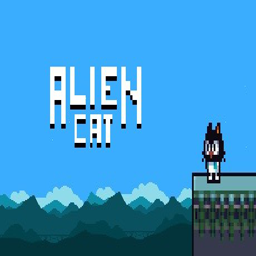

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 409210, title: Terraria: Official Soundtrack, Score: 0.6893936991691589
선택된 게임의 content: This is additional content for Terraria, but does not include the base game.
선택된 게임의 genres: ['Adventure', 'Action', 'RPG', 'Indie', 'Survival', 'Sandbox', '2D', 'Multiplayer', 'Music', 'Great Soundtrack', 'Building', 'Pixel Graphics', 'Soundtrack', 'Co-op']


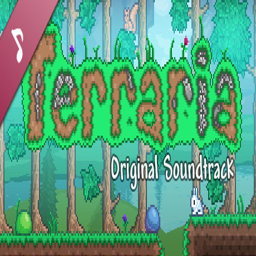

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1201840, title: MAN STANDING, Score: 0.6532120108604431
선택된 게임의 content: The ALFINA GAMERS team together with ALFINA WORLD GAME PUBLISHING are pleased to present a unique game experience. Get ready to challenge nature, incredible dangers, serious enemies, and most importantly - yourself.
선택된 게임의 genres: ['Adventure', 'Action', 'Simulation', 'Indie', 'Philosophical', 'Walking Simulator', 'Story Rich', 'Atmospheric', 'Parody ', 'Violent', 'Gore', 'Memes', 'Great Soundtrack', 'Exploration', 'Psychological Horror', 'Mystery', 'Anime', 'Hentai', 'Sexual Content']


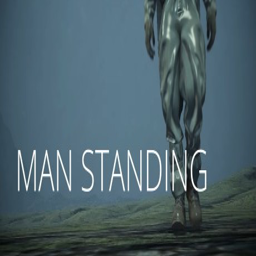

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 401280, title: Nubs' Adventure, Score: 0.6414342522621155
선택된 게임의 content: Nubs' Adventure is platforming action and exploration combined with an intriguing story and a vast world to explore!
선택된 게임의 genres: ['Action', 'Adventure', 'Indie', 'Platformer', 'Pixel Graphics']


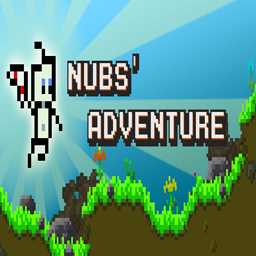

----------------------------------------------------------------------------------------------------


In [ ]:
img_seq2vec = np.concatenate([img_vecs, seq_vecs], axis = 1)
get_sim_game(img_seq2vec, 1215, top = 5)

## 장르 + 순서

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


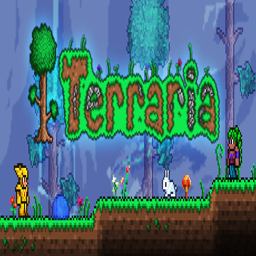

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 211820, title: Starbound, Score: 0.7419684529304504
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


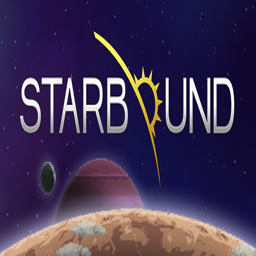

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 892970, title: Valheim, Score: 0.6044250726699829
선택된 게임의 content: A brutal exploration and survival game for 1-10 players, set in a procedurally-generated purgatory inspired by viking culture. Battle, build, and conquer your way to a saga worthy of Odin’s patronage!
선택된 게임의 genres: ['Open World Survival Craft', 'Online Co-Op', 'Survival', 'Open World', 'Crafting', 'Building', 'Exploration', 'Multiplayer', 'Co-op', 'Base Building', 'Mythology', 'Sandbox', 'Adventure', 'Sailing', 'RPG', 'Early Access', 'Action', 'Indie', 'PvP', 'Fishing']


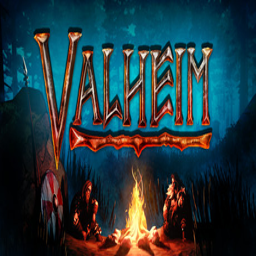

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 248820, title: Risk of Rain, Score: 0.5783481001853943
선택된 게임의 content: Risk of Rain is an action platformer with roguelike elements. With permanent death as a primary feature, players will have to play their best to get as far as possible. Fight on a mysterious planet with randomly spawning enemies and bosses, either alone or with 3 friends in online co-op.
선택된 게임의 genres: ['Action Roguelike', 'Roguelike', 'Indie', 'Platformer', 'Action', 'Pixel Graphics', 'Great Soundtrack', 'Online Co-Op', 'Difficult', 'Perma Death', 'Co-op', '2D', 'Local Co-Op', 'Roguelite', 'Multiplayer', 'RPG', 'Singleplayer', 'Addictive', 'Replay Value', 'Survival']


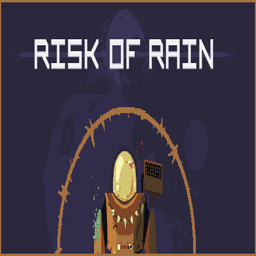

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1281930, title: tModLoader, Score: 0.5775909423828125
선택된 게임의 content: Dig, Fight, and Build your way through the world of player-created mods on Terraria with tModLoader - this DLC makes modding Terraria a reality!
선택된 게임의 genres: ['Adventure', 'Action', 'Indie', 'RPG', 'Free to Play', 'Mod', 'Sandbox', 'Moddable', 'Multiplayer', 'Building', '2D', 'Pixel Graphics', 'Survival', 'Singleplayer', 'Great Soundtrack', 'Replay Value', 'Co-op', 'Open World Survival Craft', 'Online Co-Op', 'Difficult']


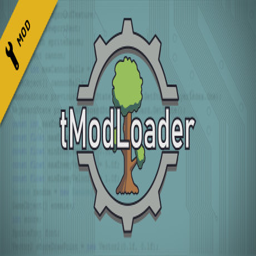

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 252490, title: Rust, Score: 0.5547035932540894
선택된 게임의 content: The only aim in Rust is to survive. Everything wants you to die - the island’s wildlife and other inhabitants, the environment, other survivors. Do whatever it takes to last another night.
선택된 게임의 genres: ['Survival', 'Crafting', 'Multiplayer', 'Open World', 'Open World Survival Craft', 'Building', 'Sandbox', 'PvP', 'Adventure', 'First-Person', 'Action', 'FPS', 'Nudity', 'Co-op', 'Shooter', 'Online Co-Op', 'Indie', 'Early Access', 'Post-apocalyptic', 'Simulation']


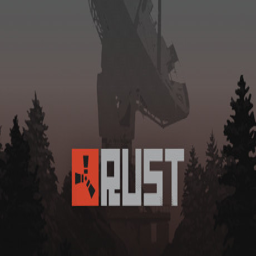

----------------------------------------------------------------------------------------------------


In [ ]:
norm_gen_seq2vec = np.concatenate([norm_gen_vecs, norm_seq_vecs], axis = 1)
get_sim_game(norm_gen_seq2vec, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


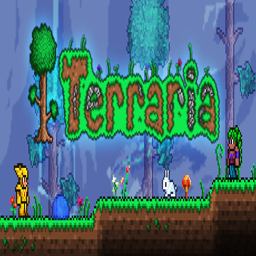

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 211820, title: Starbound, Score: 0.7297371029853821
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


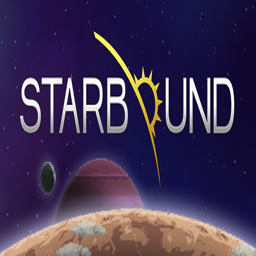

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 892970, title: Valheim, Score: 0.5913546681404114
선택된 게임의 content: A brutal exploration and survival game for 1-10 players, set in a procedurally-generated purgatory inspired by viking culture. Battle, build, and conquer your way to a saga worthy of Odin’s patronage!
선택된 게임의 genres: ['Open World Survival Craft', 'Online Co-Op', 'Survival', 'Open World', 'Crafting', 'Building', 'Exploration', 'Multiplayer', 'Co-op', 'Base Building', 'Mythology', 'Sandbox', 'Adventure', 'Sailing', 'RPG', 'Early Access', 'Action', 'Indie', 'PvP', 'Fishing']


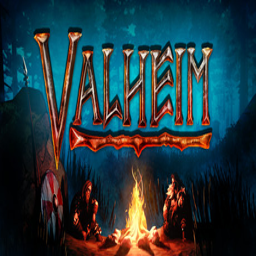

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 248820, title: Risk of Rain, Score: 0.5270777940750122
선택된 게임의 content: Risk of Rain is an action platformer with roguelike elements. With permanent death as a primary feature, players will have to play their best to get as far as possible. Fight on a mysterious planet with randomly spawning enemies and bosses, either alone or with 3 friends in online co-op.
선택된 게임의 genres: ['Action Roguelike', 'Roguelike', 'Indie', 'Platformer', 'Action', 'Pixel Graphics', 'Great Soundtrack', 'Online Co-Op', 'Difficult', 'Perma Death', 'Co-op', '2D', 'Local Co-Op', 'Roguelite', 'Multiplayer', 'RPG', 'Singleplayer', 'Addictive', 'Replay Value', 'Survival']


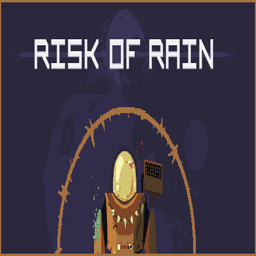

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 238240, title: Edge of Space, Score: 0.5197141170501709
선택된 게임의 content: Suit up as an operative of the Ark Corporation, sent to the farthest reaches of the universe in search of habitable planets to terraform. However, after the long space journey you awaken from cryosleep to find that your ship has gone way off course and is disabled near a strange new world.
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Indie', 'Adventure', '2D', 'Action', 'Crafting', 'Space', 'Sci-fi', 'RPG', 'Survival', 'Multiplayer', 'Open World', 'Platformer', 'Co-op', 'Building', 'Early Access', 'Pixel Graphics', 'Exploration', 'Side Scroller']


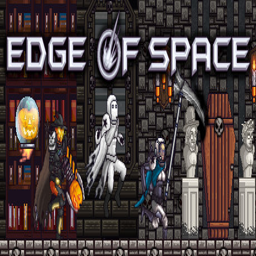

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 1281930, title: tModLoader, Score: 0.4874217212200165
선택된 게임의 content: Dig, Fight, and Build your way through the world of player-created mods on Terraria with tModLoader - this DLC makes modding Terraria a reality!
선택된 게임의 genres: ['Adventure', 'Action', 'Indie', 'RPG', 'Free to Play', 'Mod', 'Sandbox', 'Moddable', 'Multiplayer', 'Building', '2D', 'Pixel Graphics', 'Survival', 'Singleplayer', 'Great Soundtrack', 'Replay Value', 'Co-op', 'Open World Survival Craft', 'Online Co-Op', 'Difficult']


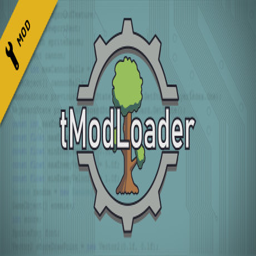

----------------------------------------------------------------------------------------------------


In [ ]:
standard_gen_seq2vec = np.concatenate([standard_gen_vecs, standard_seq_vecs], axis = 1)
get_sim_game(standard_gen_seq2vec, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


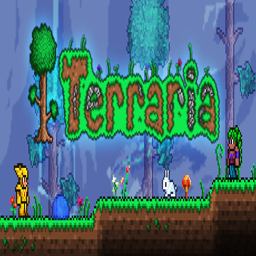

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 211820, title: Starbound, Score: 0.9931811094284058
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


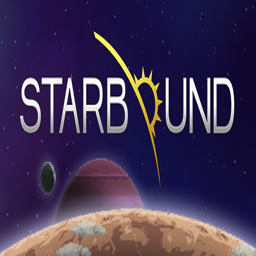

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 892970, title: Valheim, Score: 0.9904175996780396
선택된 게임의 content: A brutal exploration and survival game for 1-10 players, set in a procedurally-generated purgatory inspired by viking culture. Battle, build, and conquer your way to a saga worthy of Odin’s patronage!
선택된 게임의 genres: ['Open World Survival Craft', 'Online Co-Op', 'Survival', 'Open World', 'Crafting', 'Building', 'Exploration', 'Multiplayer', 'Co-op', 'Base Building', 'Mythology', 'Sandbox', 'Adventure', 'Sailing', 'RPG', 'Early Access', 'Action', 'Indie', 'PvP', 'Fishing']


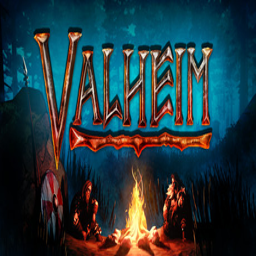

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 248820, title: Risk of Rain, Score: 0.9882751107215881
선택된 게임의 content: Risk of Rain is an action platformer with roguelike elements. With permanent death as a primary feature, players will have to play their best to get as far as possible. Fight on a mysterious planet with randomly spawning enemies and bosses, either alone or with 3 friends in online co-op.
선택된 게임의 genres: ['Action Roguelike', 'Roguelike', 'Indie', 'Platformer', 'Action', 'Pixel Graphics', 'Great Soundtrack', 'Online Co-Op', 'Difficult', 'Perma Death', 'Co-op', '2D', 'Local Co-Op', 'Roguelite', 'Multiplayer', 'RPG', 'Singleplayer', 'Addictive', 'Replay Value', 'Survival']


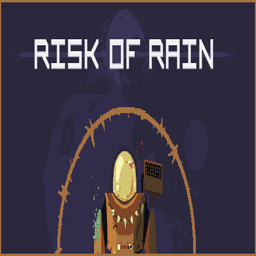

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 346110, title: ARK: Survival Evolved, Score: 0.9881206154823303
선택된 게임의 content: Stranded on the shores of a mysterious island, you must learn to survive. Use your cunning to kill or tame the primeval creatures roaming the land, and encounter other players to survive, dominate... and escape!
선택된 게임의 genres: ['Open World Survival Craft', 'Survival', 'Open World', 'Multiplayer', 'Dinosaurs', 'Crafting', 'Building', 'Adventure', 'Base Building', 'Co-op', 'Action', 'First-Person', 'Sandbox', 'Massively Multiplayer', 'Singleplayer', 'Early Access', 'RPG', 'Dragons', 'Sci-fi', 'Indie']


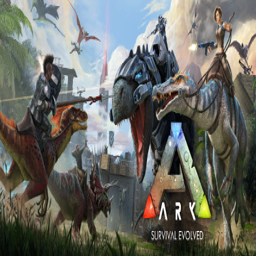

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 220240, title: Far Cry 3, Score: 0.9873159527778625
선택된 게임의 content: Discover the dark secrets of a lawless island ruled by violence and take the fight to the enemy as you try to escape. You’ll need more than luck to escape alive!
선택된 게임의 genres: ['Open World', 'FPS', 'Action', 'Adventure', 'Shooter', 'Multiplayer', 'Stealth', 'First-Person', 'Hunting', 'Co-op', 'Singleplayer', 'Sandbox', 'Survival', 'Story Rich', 'Online Co-Op', 'Atmospheric', 'Nudity', 'Colorful', 'Crafting', 'RPG']


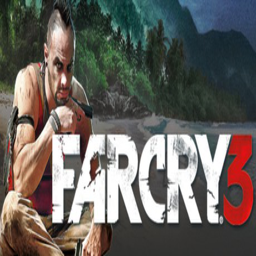

----------------------------------------------------------------------------------------------------


In [ ]:
min_max_gen_seq2vec = np.concatenate([min_max_gen_vecs, min_max_seq_vecs], axis = 1)
get_sim_game(min_max_gen_seq2vec, 1215, top = 5)

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 105600, 선택된 게임의 title: Terraria
선택된 게임의 content: Dig, fight, explore, build! Nothing is impossible in this action-packed adventure game. Four Pack also available!
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', '2D', 'Multiplayer', 'Adventure', 'Crafting', 'Building', 'Pixel Graphics', 'Exploration', 'Co-op', 'Open World', 'Indie', 'Online Co-Op', 'Action', 'RPG', 'Singleplayer', 'Replay Value', 'Platformer', 'Atmospheric']


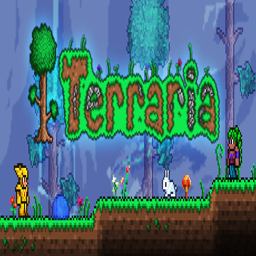

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 211820, title: Starbound, Score: 0.7610507011413574
선택된 게임의 content: You’ve fled your home, only to find yourself lost in space with a damaged ship. Your only option is to beam down to the planet below, repair your ship and set off to explore the universe...
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Survival', 'Adventure', 'Space', 'Crafting', 'Online Co-Op', 'Relaxing', 'Pixel Graphics', 'Multiplayer', 'Open World', 'Exploration', 'Indie', 'Action', '2D', 'RPG', 'Co-op', 'Atmospheric', 'Building', 'Sci-fi']


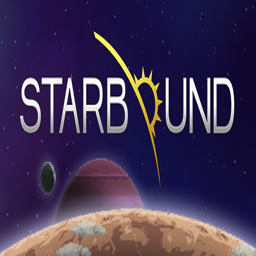

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 892970, title: Valheim, Score: 0.6361332535743713
선택된 게임의 content: A brutal exploration and survival game for 1-10 players, set in a procedurally-generated purgatory inspired by viking culture. Battle, build, and conquer your way to a saga worthy of Odin’s patronage!
선택된 게임의 genres: ['Open World Survival Craft', 'Online Co-Op', 'Survival', 'Open World', 'Crafting', 'Building', 'Exploration', 'Multiplayer', 'Co-op', 'Base Building', 'Mythology', 'Sandbox', 'Adventure', 'Sailing', 'RPG', 'Early Access', 'Action', 'Indie', 'PvP', 'Fishing']


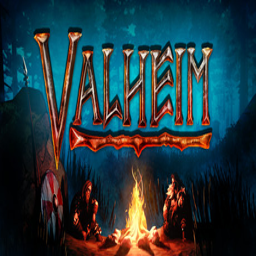

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 248820, title: Risk of Rain, Score: 0.5739245414733887
선택된 게임의 content: Risk of Rain is an action platformer with roguelike elements. With permanent death as a primary feature, players will have to play their best to get as far as possible. Fight on a mysterious planet with randomly spawning enemies and bosses, either alone or with 3 friends in online co-op.
선택된 게임의 genres: ['Action Roguelike', 'Roguelike', 'Indie', 'Platformer', 'Action', 'Pixel Graphics', 'Great Soundtrack', 'Online Co-Op', 'Difficult', 'Perma Death', 'Co-op', '2D', 'Local Co-Op', 'Roguelite', 'Multiplayer', 'RPG', 'Singleplayer', 'Addictive', 'Replay Value', 'Survival']


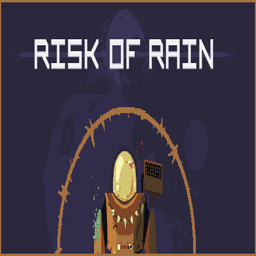

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 238240, title: Edge of Space, Score: 0.5728946328163147
선택된 게임의 content: Suit up as an operative of the Ark Corporation, sent to the farthest reaches of the universe in search of habitable planets to terraform. However, after the long space journey you awaken from cryosleep to find that your ship has gone way off course and is disabled near a strange new world.
선택된 게임의 genres: ['Open World Survival Craft', 'Sandbox', 'Indie', 'Adventure', '2D', 'Action', 'Crafting', 'Space', 'Sci-fi', 'RPG', 'Survival', 'Multiplayer', 'Open World', 'Platformer', 'Co-op', 'Building', 'Early Access', 'Pixel Graphics', 'Exploration', 'Side Scroller']


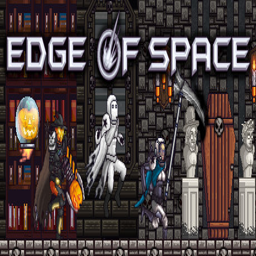

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 1281930, title: tModLoader, Score: 0.5609836578369141
선택된 게임의 content: Dig, Fight, and Build your way through the world of player-created mods on Terraria with tModLoader - this DLC makes modding Terraria a reality!
선택된 게임의 genres: ['Adventure', 'Action', 'Indie', 'RPG', 'Free to Play', 'Mod', 'Sandbox', 'Moddable', 'Multiplayer', 'Building', '2D', 'Pixel Graphics', 'Survival', 'Singleplayer', 'Great Soundtrack', 'Replay Value', 'Co-op', 'Open World Survival Craft', 'Online Co-Op', 'Difficult']


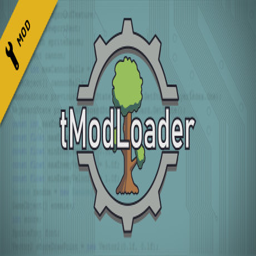

----------------------------------------------------------------------------------------------------


In [ ]:
gen_seq2vec = np.concatenate([gen_vecs, seq_vecs], axis = 1)
get_sim_game(gen_seq2vec, 1215, top = 5)

## 이미지 + 장르 + 순서

In [ ]:
usser_df = pd.read_csv(DATA_DIR + 'steam_reviews_clean_result.csv')
usser_df.head()

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id
0,"Very good game, within 6 hours from launch, th...",Recommended,atgbui,768520,2021-06-20,3042.0,3042.0,https://store.steampowered.com/app/768520,5,19302,15392
1,I cannot recommend this game. It's been 8 year...,Not Recommended,atgbui,251570,2021-06-14,40440.0,40440.0,https://store.steampowered.com/app/251570,48,19302,2415
2,Game is currently busted for Co-Op. Despite th...,Not Recommended,atgbui,671510,2021-06-12,1734.0,906.0,https://store.steampowered.com/app/671510,3,19302,13585
3,Unfortunately dead game. https://steamcharts.c...,Not Recommended,atgbui,613590,2021-06-12,48.0,48.0,https://store.steampowered.com/app/613590,0,19302,12513
4,It just felt too generic- why would I play thi...,Not Recommended,atgbui,374280,2021-05-20,540.0,540.0,https://store.steampowered.com/app/374280,1,19302,6269


In [ ]:
a = usser_df[usser_df['user_id'] == 'atgbui']

In [ ]:
a[a['recommended'] == 'Recommended']

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id
0,"Very good game, within 6 hours from launch, th...",Recommended,atgbui,768520,2021-06-20,3042.0,3042.0,https://store.steampowered.com/app/768520,5,19302,15392
11,I hopped into this game thinking it would be u...,Recommended,atgbui,226700,2021-04-04,2292.0,78.0,https://store.steampowered.com/app/226700,1,19302,1874
12,"It's actually a fun little game, unfortunately...",Recommended,atgbui,979800,2021-04-03,54.0,54.0,https://store.steampowered.com/app/979800,0,19302,18456
14,A very good deckbuilding roguelite- with very ...,Recommended,atgbui,994220,2021-04-01,1620.0,1620.0,https://store.steampowered.com/app/994220,3,19302,18610
15,"Game is was great, I just wish they had a WASD...",Recommended,atgbui,1235360,2021-03-31,396.0,396.0,https://store.steampowered.com/app/1235360,0,19302,21057
18,"The game is quite fun, I like the fact you don...",Recommended,atgbui,718650,2021-01-31,1260.0,1026.0,https://store.steampowered.com/app/718650,1,19302,14487
20,"Despite being a game about 8 years old, it see...",Recommended,atgbui,108600,2020-12-24,666.0,666.0,https://store.steampowered.com/app/108600,0,19302,1232
23,This review is a work in progress and will add...,Recommended,atgbui,299740,2020-11-10,9048.0,7434.0,https://store.steampowered.com/app/299740,37,19302,3707
24,Not sure what the issue is with all the bad re...,Recommended,atgbui,1226470,2020-08-01,738.0,198.0,https://store.steampowered.com/app/1226470,1,19302,20977
25,First I'd like to discuss activity since most ...,Recommended,atgbui,879160,2019-08-11,3708.0,552.0,https://store.steampowered.com/app/879160,4,19302,17195


In [ ]:
content_df[content_df['game_id'] == 226700]

,game_id,title,content,Image_url,genres,clean_genres,appid,name,developer,publisher,score_rank,positive,negative,userscore,owners,average_forever,average_2weeks,median_forever,median_2weeks,price,initialprice,discount,languages,genre,ccu,tags,label_encode_game_id,game_total_cnt,game_rec_cnt,game_not_rec_cnt,recommend_ratio,not_recommend_ratio,game_total_avg_play_time,game_rec_avg_play_time,game_not_rec_avg_play_time,idx
1874,226700,Infestation: Survivor Stories 2020,Infestation is a Survival Horror MMO that imme...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tZombies\t\t\t\t\...,"['Zombies', 'Survival', 'Massively Multiplayer...",226700,Infestation: Survivor Stories 2020,Fredaikis AB,OP Productions LLC,NaN,10707,14883,0,"1,000,000 .. 2,000,000",1068,0,546,0,0.0,0.0,0.0,"English, French, German, Simplified Chinese, P...","Action, Free to Play, Indie, Massively Multipl...",36,"{'Zombies': 809, 'Survival': 597, 'Massively M...",1874,215,54.0,161.0,0.251163,0.748837,3384.446512,5672.777778,2616.931677,1874


----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 226700, 선택된 게임의 title: Infestation: Survivor Stories 2020
선택된 게임의 content: Infestation is a Survival Horror MMO that immerses players in a zombie-infested, post-apocalyptic world in which a viral outbreak has decimated the human population leaving in its wake, a nightmare of epic proportion.
선택된 게임의 genres: ['Zombies', 'Survival', 'Massively Multiplayer', 'Action', 'Open World', 'PvP', 'Multiplayer', 'RPG', 'Indie', 'Simulation', 'FPS', 'Co-op', 'Horror', 'Post-apocalyptic', 'Shooter', 'PvE', 'Third-Person Shooter', 'Third Person', 'Free to Play', 'Casual']


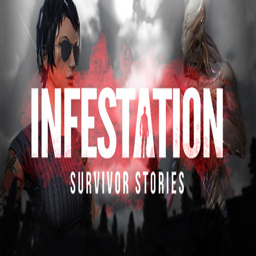

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 221100, title: DayZ, Score: 0.4773935377597809
선택된 게임의 content: How long can you survive a post-apocalyptic world? A land overrun with an infected "zombie" population, where you compete with other survivors for limited resources. Will you team up with strangers and stay strong together? Or play as a lone wolf to avoid betrayal? This is DayZ – this is your story.
선택된 게임의 genres: ['Survival', 'Zombies', 'Multiplayer', 'Open World', 'Action', 'PvP', 'Shooter', 'Massively Multiplayer', 'Horror', 'Simulation', 'Early Access', 'Post-apocalyptic', 'FPS', 'First-Person', 'Survival Horror', 'Sandbox', 'Adventure', 'Co-op', 'Indie', 'Atmospheric']


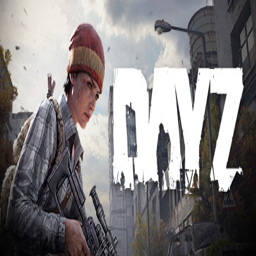

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 337950, title: The SKIES - BETA, Score: 0.46499431133270264
선택된 게임의 content: The Skies is a unique combination of post-apocalyptic MMORPG and FPS with a non-linear storyline, in which you follow your own path or join other players to conquer the wasteland.
선택된 게임의 genres: ['Free to Play', 'Survival', 'Multiplayer', 'Open World', 'Massively Multiplayer', 'Post-apocalyptic', 'Shooter', 'Zombies', 'Early Access', 'RPG', 'Crafting', 'FPS', 'Action', 'Co-op', 'First-Person', 'PvP', 'Adventure', 'Third Person', 'Third-Person Shooter', 'Horror']


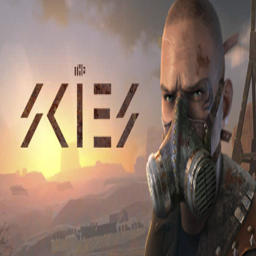

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 555570, title: Infestation: The New Z, Score: 0.46145346760749817
선택된 게임의 content: The New Z is a FREE TO PLAY multi-game mode experience. SURVIVE with friends and gather loot, stash and trade. Go into wars against other groups in a massive OPEN WORLD or face them 5 v 5 in COMPETITIVE.
선택된 게임의 genres: ['Zombies', 'Free to Play', 'Survival', 'Multiplayer', 'Open World', 'Massively Multiplayer', 'FPS', 'Action', 'Shooter', 'PvP', 'Co-op', 'Survival Horror', 'RPG', 'Adventure', 'Violent', 'Horror', 'Third-Person Shooter', 'PvE', 'Indie', 'Walking Simulator']


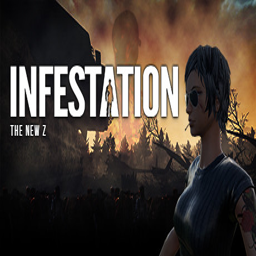

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 247730, title: Nether: Resurrected, Score: 0.45120859146118164
선택된 게임의 content: Nether is a unique, first-person, multiplayer urban survival experience. Set in a post-apocalyptic world, Nether forces players to make life-saving decisions in a fast-paced struggle against players and the environment. Join tribes, hold territory, scavenge, craft, trade and loot your way to stay alive.
선택된 게임의 genres: ['Survival', 'Open World', 'Action', 'Multiplayer', 'Massively Multiplayer', 'Post-apocalyptic', 'Horror', 'FPS', 'Zombies', 'RPG', 'PvP', 'First-Person', 'Survival Horror', 'Indie', 'Simulation', 'Co-op', 'Adventure', 'Walking Simulator', 'Crafting', 'PvE']


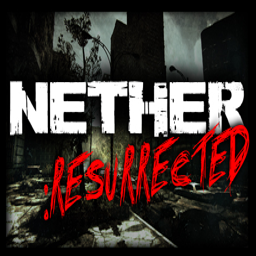

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 295110, title: Just Survive, Score: 0.44200560450553894
선택된 게임의 content: Just Survive is a post-apocalyptic survival game that immerses you in a world where humanity is fighting to take back control from the zombie hordes.
선택된 게임의 genres: ['Zombies', 'Survival', 'Open World', 'Multiplayer', 'Massively Multiplayer', 'Crafting', 'Post-apocalyptic', 'Action', 'Survival Horror', 'Co-op', 'Shooter', 'Adventure', 'Sandbox', 'Exploration', 'FPS', 'Walking Simulator', 'Horror', 'Early Access', 'Simulation', 'RPG']


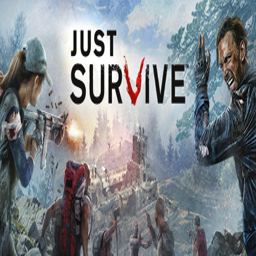

----------------------------------------------------------------------------------------------------


In [ ]:
# 마지막에서 두번째의 추천게임을 넣었을 때 그 게임 중에서 해당 유저가 추천되는 게임을 했다면 좋게 평가되었다고 가정함
get_sim_game(norm_game2vec, 1874, top = 5)

In [ ]:
a[a['game_id'] == 221100]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 337950]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 555570]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 247730]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id
38,"Review Score: -7.75/10- As of Nov. 21, 2014. '...",Recommended,atgbui,247730,2014-11-20,4824.0,4662.0,https://store.steampowered.com/app/247730,3,19302,2320


In [ ]:
a[a['game_id'] == 295110]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 226700, 선택된 게임의 title: Infestation: Survivor Stories 2020
선택된 게임의 content: Infestation is a Survival Horror MMO that immerses players in a zombie-infested, post-apocalyptic world in which a viral outbreak has decimated the human population leaving in its wake, a nightmare of epic proportion.
선택된 게임의 genres: ['Zombies', 'Survival', 'Massively Multiplayer', 'Action', 'Open World', 'PvP', 'Multiplayer', 'RPG', 'Indie', 'Simulation', 'FPS', 'Co-op', 'Horror', 'Post-apocalyptic', 'Shooter', 'PvE', 'Third-Person Shooter', 'Third Person', 'Free to Play', 'Casual']


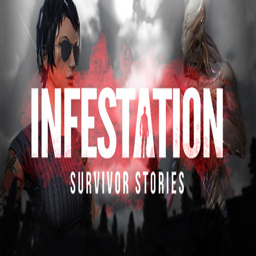

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 555570, title: Infestation: The New Z, Score: 0.4210631251335144
선택된 게임의 content: The New Z is a FREE TO PLAY multi-game mode experience. SURVIVE with friends and gather loot, stash and trade. Go into wars against other groups in a massive OPEN WORLD or face them 5 v 5 in COMPETITIVE.
선택된 게임의 genres: ['Zombies', 'Free to Play', 'Survival', 'Multiplayer', 'Open World', 'Massively Multiplayer', 'FPS', 'Action', 'Shooter', 'PvP', 'Co-op', 'Survival Horror', 'RPG', 'Adventure', 'Violent', 'Horror', 'Third-Person Shooter', 'PvE', 'Indie', 'Walking Simulator']


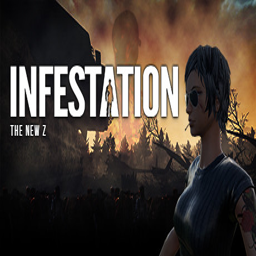

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 247730, title: Nether: Resurrected, Score: 0.402165949344635
선택된 게임의 content: Nether is a unique, first-person, multiplayer urban survival experience. Set in a post-apocalyptic world, Nether forces players to make life-saving decisions in a fast-paced struggle against players and the environment. Join tribes, hold territory, scavenge, craft, trade and loot your way to stay alive.
선택된 게임의 genres: ['Survival', 'Open World', 'Action', 'Multiplayer', 'Massively Multiplayer', 'Post-apocalyptic', 'Horror', 'FPS', 'Zombies', 'RPG', 'PvP', 'First-Person', 'Survival Horror', 'Indie', 'Simulation', 'Co-op', 'Adventure', 'Walking Simulator', 'Crafting', 'PvE']


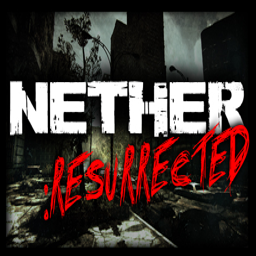

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 337950, title: The SKIES - BETA, Score: 0.38870805501937866
선택된 게임의 content: The Skies is a unique combination of post-apocalyptic MMORPG and FPS with a non-linear storyline, in which you follow your own path or join other players to conquer the wasteland.
선택된 게임의 genres: ['Free to Play', 'Survival', 'Multiplayer', 'Open World', 'Massively Multiplayer', 'Post-apocalyptic', 'Shooter', 'Zombies', 'Early Access', 'RPG', 'Crafting', 'FPS', 'Action', 'Co-op', 'First-Person', 'PvP', 'Adventure', 'Third Person', 'Third-Person Shooter', 'Horror']


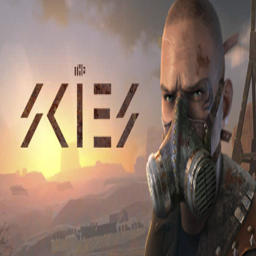

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 221100, title: DayZ, Score: 0.37382954359054565
선택된 게임의 content: How long can you survive a post-apocalyptic world? A land overrun with an infected "zombie" population, where you compete with other survivors for limited resources. Will you team up with strangers and stay strong together? Or play as a lone wolf to avoid betrayal? This is DayZ – this is your story.
선택된 게임의 genres: ['Survival', 'Zombies', 'Multiplayer', 'Open World', 'Action', 'PvP', 'Shooter', 'Massively Multiplayer', 'Horror', 'Simulation', 'Early Access', 'Post-apocalyptic', 'FPS', 'First-Person', 'Survival Horror', 'Sandbox', 'Adventure', 'Co-op', 'Indie', 'Atmospheric']


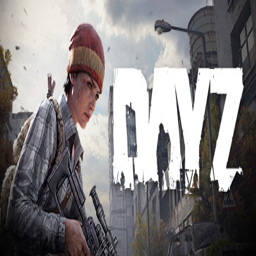

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 295110, title: Just Survive, Score: 0.36465269327163696
선택된 게임의 content: Just Survive is a post-apocalyptic survival game that immerses you in a world where humanity is fighting to take back control from the zombie hordes.
선택된 게임의 genres: ['Zombies', 'Survival', 'Open World', 'Multiplayer', 'Massively Multiplayer', 'Crafting', 'Post-apocalyptic', 'Action', 'Survival Horror', 'Co-op', 'Shooter', 'Adventure', 'Sandbox', 'Exploration', 'FPS', 'Walking Simulator', 'Horror', 'Early Access', 'Simulation', 'RPG']


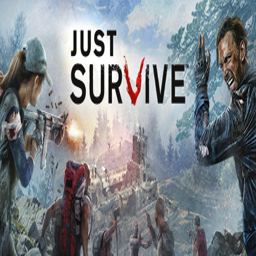

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(standard_game2vec, 1874, top = 5)

In [ ]:
a[a['game_id'] == 555570]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 247730]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id
38,"Review Score: -7.75/10- As of Nov. 21, 2014. '...",Recommended,atgbui,247730,2014-11-20,4824.0,4662.0,https://store.steampowered.com/app/247730,3,19302,2320


In [ ]:
a[a['game_id'] == 337950]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 221100]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 295110]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 226700, 선택된 게임의 title: Infestation: Survivor Stories 2020
선택된 게임의 content: Infestation is a Survival Horror MMO that immerses players in a zombie-infested, post-apocalyptic world in which a viral outbreak has decimated the human population leaving in its wake, a nightmare of epic proportion.
선택된 게임의 genres: ['Zombies', 'Survival', 'Massively Multiplayer', 'Action', 'Open World', 'PvP', 'Multiplayer', 'RPG', 'Indie', 'Simulation', 'FPS', 'Co-op', 'Horror', 'Post-apocalyptic', 'Shooter', 'PvE', 'Third-Person Shooter', 'Third Person', 'Free to Play', 'Casual']


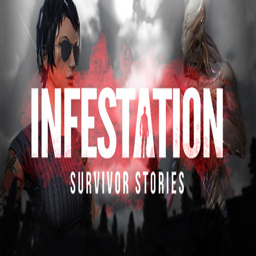

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 247730, title: Nether: Resurrected, Score: 0.9830219745635986
선택된 게임의 content: Nether is a unique, first-person, multiplayer urban survival experience. Set in a post-apocalyptic world, Nether forces players to make life-saving decisions in a fast-paced struggle against players and the environment. Join tribes, hold territory, scavenge, craft, trade and loot your way to stay alive.
선택된 게임의 genres: ['Survival', 'Open World', 'Action', 'Multiplayer', 'Massively Multiplayer', 'Post-apocalyptic', 'Horror', 'FPS', 'Zombies', 'RPG', 'PvP', 'First-Person', 'Survival Horror', 'Indie', 'Simulation', 'Co-op', 'Adventure', 'Walking Simulator', 'Crafting', 'PvE']


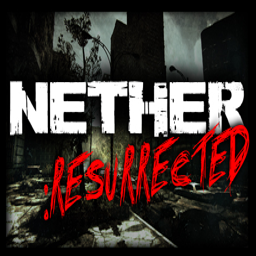

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 221100, title: DayZ, Score: 0.9826596975326538
선택된 게임의 content: How long can you survive a post-apocalyptic world? A land overrun with an infected "zombie" population, where you compete with other survivors for limited resources. Will you team up with strangers and stay strong together? Or play as a lone wolf to avoid betrayal? This is DayZ – this is your story.
선택된 게임의 genres: ['Survival', 'Zombies', 'Multiplayer', 'Open World', 'Action', 'PvP', 'Shooter', 'Massively Multiplayer', 'Horror', 'Simulation', 'Early Access', 'Post-apocalyptic', 'FPS', 'First-Person', 'Survival Horror', 'Sandbox', 'Adventure', 'Co-op', 'Indie', 'Atmospheric']


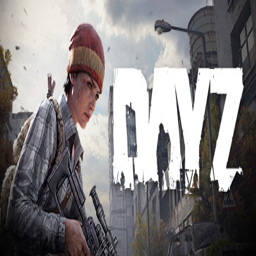

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 555570, title: Infestation: The New Z, Score: 0.9824042916297913
선택된 게임의 content: The New Z is a FREE TO PLAY multi-game mode experience. SURVIVE with friends and gather loot, stash and trade. Go into wars against other groups in a massive OPEN WORLD or face them 5 v 5 in COMPETITIVE.
선택된 게임의 genres: ['Zombies', 'Free to Play', 'Survival', 'Multiplayer', 'Open World', 'Massively Multiplayer', 'FPS', 'Action', 'Shooter', 'PvP', 'Co-op', 'Survival Horror', 'RPG', 'Adventure', 'Violent', 'Horror', 'Third-Person Shooter', 'PvE', 'Indie', 'Walking Simulator']


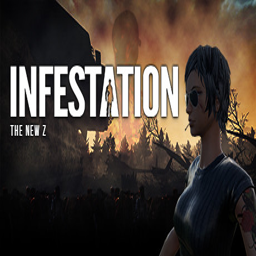

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 241540, title: State of Decay, Score: 0.9820093512535095
선택된 게임의 content: The end is here. Life as you knew it has gone to hell after the mother of all zombie outbreaks. Now you and the few scattered survivors must band together to survive and rebuild in a 3rd-person action game set in a dynamic open world.
선택된 게임의 genres: ['Zombies', 'Survival', 'Open World', 'Action', 'Post-apocalyptic', 'RPG', 'Third Person', 'Base Building', 'Singleplayer', 'Sandbox', 'Simulation', 'Multiplayer', 'Exploration', 'Adventure', 'Horror', 'Third-Person Shooter', 'Survival Horror', 'Atmospheric', 'Co-op', 'Indie']


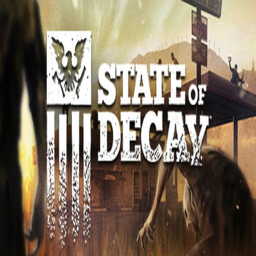

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 337950, title: The SKIES - BETA, Score: 0.9819889068603516
선택된 게임의 content: The Skies is a unique combination of post-apocalyptic MMORPG and FPS with a non-linear storyline, in which you follow your own path or join other players to conquer the wasteland.
선택된 게임의 genres: ['Free to Play', 'Survival', 'Multiplayer', 'Open World', 'Massively Multiplayer', 'Post-apocalyptic', 'Shooter', 'Zombies', 'Early Access', 'RPG', 'Crafting', 'FPS', 'Action', 'Co-op', 'First-Person', 'PvP', 'Adventure', 'Third Person', 'Third-Person Shooter', 'Horror']


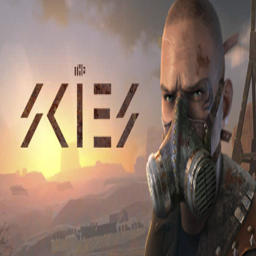

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(min_max_game2vec, 1874, top = 5)

In [ ]:
a[a['game_id'] == 247730]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id
38,"Review Score: -7.75/10- As of Nov. 21, 2014. '...",Recommended,atgbui,247730,2014-11-20,4824.0,4662.0,https://store.steampowered.com/app/247730,3,19302,2320


In [ ]:
a[a['game_id'] == 221100]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 555570]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 241540]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 337950]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 226700, 선택된 게임의 title: Infestation: Survivor Stories 2020
선택된 게임의 content: Infestation is a Survival Horror MMO that immerses players in a zombie-infested, post-apocalyptic world in which a viral outbreak has decimated the human population leaving in its wake, a nightmare of epic proportion.
선택된 게임의 genres: ['Zombies', 'Survival', 'Massively Multiplayer', 'Action', 'Open World', 'PvP', 'Multiplayer', 'RPG', 'Indie', 'Simulation', 'FPS', 'Co-op', 'Horror', 'Post-apocalyptic', 'Shooter', 'PvE', 'Third-Person Shooter', 'Third Person', 'Free to Play', 'Casual']


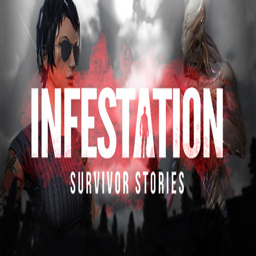

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 922450, title: 4X-Galaxy 无主之地：银河, Score: 0.6198325157165527
선택된 게임의 content: “4X-Galaxy” is a game developed by the 4X concept system(eXplore、eXpand、eXploit、eXterminate)
선택된 게임의 genres: ['Massively Multiplayer', 'Free to Play', 'Strategy', 'Indie', 'Adventure', 'RPG', 'Space', '4X', 'Sandbox', 'Open World']


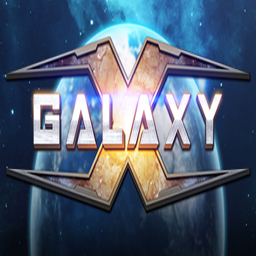

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 657810, title: Blessed Surface, Score: 0.6097845435142517
선택된 게임의 content: An open-world 2d platformer, Blessed Surface uses the side-scrolling perspective to create a deep, greatly vertical space with no sky, only endless passages upwards. A functioning ecosystem, equipment customization, dynamic encounters and more form a rich, living world.
선택된 게임의 genres: ['Metroidvania', 'Bullet Hell', 'Souls-like', '2D Platformer', 'Exploration', 'Open World', 'Sandbox', 'PvE', 'Difficult', 'Platformer', 'Character Customization', 'RPG', '2D', 'Lore-Rich', 'Surreal', 'Conversation', 'Action', 'Pixel Graphics', 'Colorful', 'Dark Fantasy']


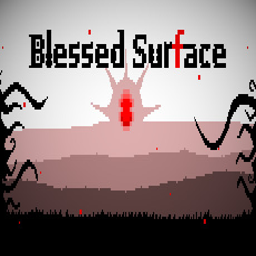

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 286140, title: Eidolon, Score: 0.5844370126724243
선택된 게임의 content: Narrative exploration game located in a massive, post-human Western Washington. Navigate an open world that has been reclaimed by nature. Use journals, letters, zines, and other documents to learn the interconnected stories of the people who lived here once.
선택된 게임의 genres: ['Exploration', 'Open World', 'Survival', 'Walking Simulator', 'Adventure', 'Indie', 'Atmospheric', 'Nature', 'Post-apocalyptic', 'First-Person', 'Great Soundtrack']


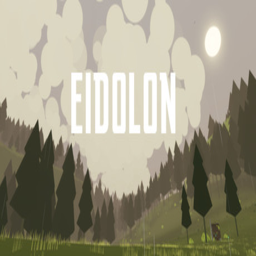

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 771130, title: Sad City 42, Score: 0.5731573104858398
선택된 게임의 content: Learn the story of a simple Russian Vlad, who is trying to survive in Russia.
선택된 게임의 genres: ['Adventure', 'Casual', 'Indie', 'Action', 'RPG', 'Visual Novel']


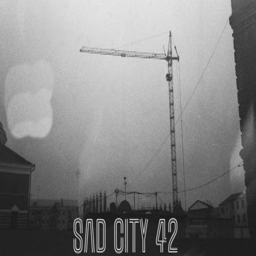

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 758990, title: Ancient Warfare 3, Score: 0.5582589507102966
선택된 게임의 content: Dive into a huge sandbox full of action and customization! Choose from different gamemodes or create you own scenarios in the custom battle editor. Change the rules and the environment, place units, objects or traps, choose your equipment or spectate a battle...
선택된 게임의 genres: ['Action', 'Simulation', 'Strategy', 'Indie', 'Sandbox', 'Early Access', 'War', 'Singleplayer', 'Moddable']


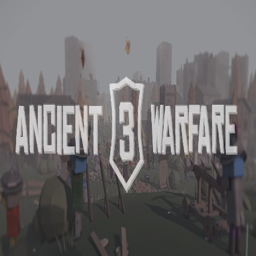

----------------------------------------------------------------------------------------------------


In [ ]:
get_sim_game(game2vec, 1874, top = 5)

In [ ]:
a[a['game_id'] == 922450]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 657810]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 286140]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 771130]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


In [ ]:
a[a['game_id'] == 758990]

,content,recommended,user_id,game_id,timestamp,play_time_minute,review_time_minute,game_content_link,review_helpful_count,label_encode_user_id,label_encode_game_id


# 저장

In [ ]:
import pickle

DATA_DIR = '/content/drive/MyDrive/투빅스 컨퍼런스/Data/'

# norm_game2vec
with open(DATA_DIR + 'norm_game2vec.pickle', 'wb') as f:
  pickle.dump(norm_game2vec, f, pickle.HIGHEST_PROTOCOL)